# Hands-on Image Processing with Python
## Chapter 2: Sampling & Fourier Transform 
## Chapter 3: Convolution and Frequency domain Filtering

In [1]:
# Author: Sandipan Dey

In [1]:
%matplotlib inline
from scipy.misc import lena, face
import numpy as np
import matplotlib.pylab as plt
from PIL import Image
import scipy.fftpack as fp
from scipy.stats import signaltonoise
from skimage import data, img_as_float
from skimage.io import imread, imshow, show

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:2: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0
  from ipykernel import kernelapp as app
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:7: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


SNR for the original image = 2.023722773801701
SNR for the image obtained after FFT + IFFT = 2.023722773801701


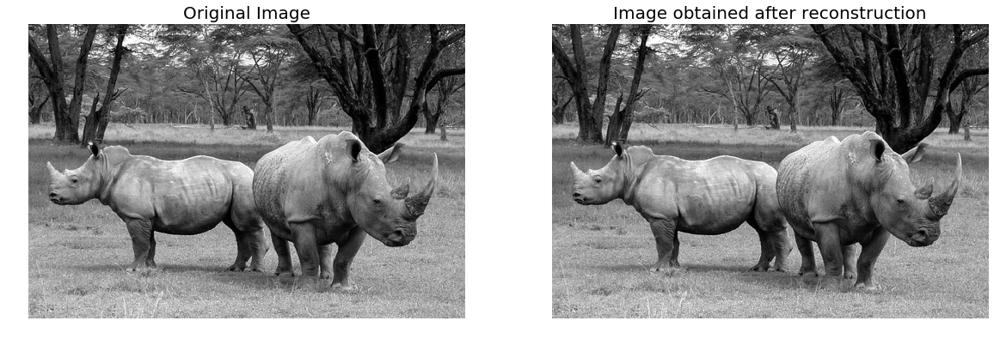

In [74]:
im = np.array(Image.open('../new images/rhino.jpg').convert('L'))
snr = signaltonoise(im, axis=None)
print('SNR for the original image = ' + str(snr))

freq = fp.fft2(im)
im1 = fp.ifft2(freq).real
snr = signaltonoise(im1, axis=None)
print('SNR for the image obtained after FFT + IFFT = ' + str(snr))

# Make sure the forward and backward transforms work!
assert(np.allclose(im, im1))

plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(im, cmap='gray')
plt.axis('off')
plt.title('Original Image', size=20)
plt.subplot(122)
plt.imshow(im1, cmap='gray')
plt.axis('off')
plt.title('Image obtained after reconstruction', size=20)
#plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:8: ComplexWarning: Casting complex values to real discards the imaginary part


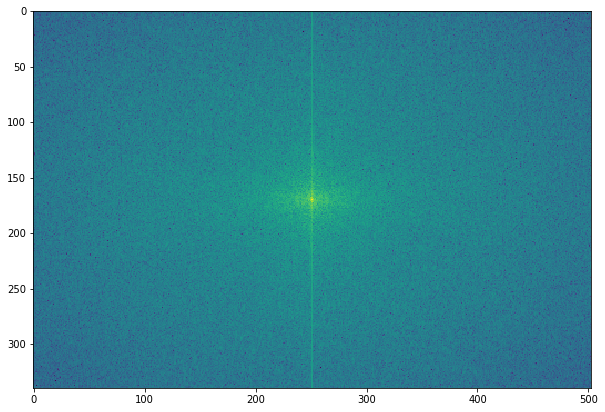

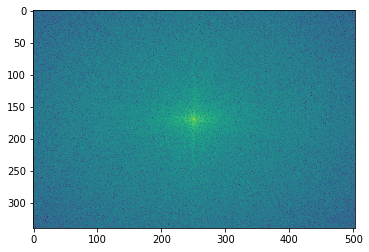

In [75]:
# import pylab as py

# Now shift the quadrants around so that low spatial frequencies are in
# the center of the 2D fourier-transformed image.
freq2 = fp.fftshift(freq)

plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + freq2)).astype(int))
#plt.gca().invert_yaxis()
#plt.colorbar()
plt.show()

# Calculate a 2D power spectrum
psd2D = np.abs( freq2 )**2
 
plt.imshow( np.log10( psd2D ))
plt.show()

0.5805237719040491


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:14: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


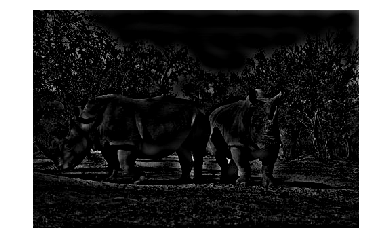

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:19: ComplexWarning: Casting complex values to real discards the imaginary part


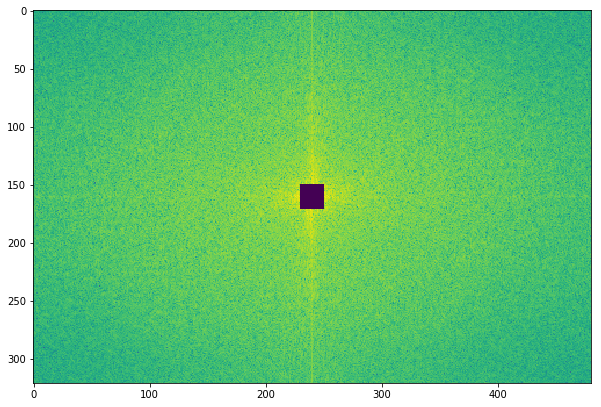

3.1988986401822856


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:29: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


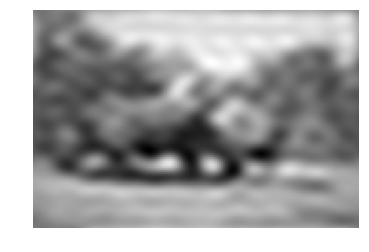

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:34: ComplexWarning: Casting complex values to real discards the imaginary part


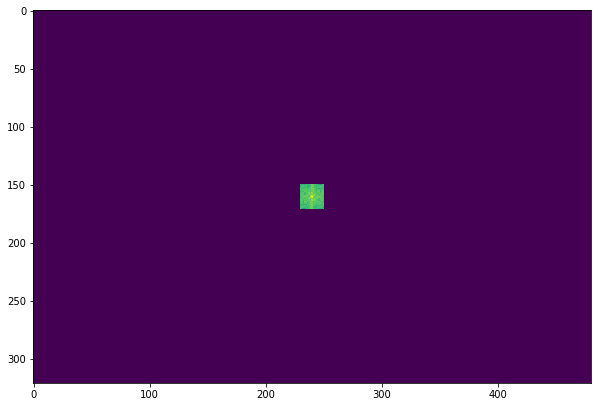

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:52: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


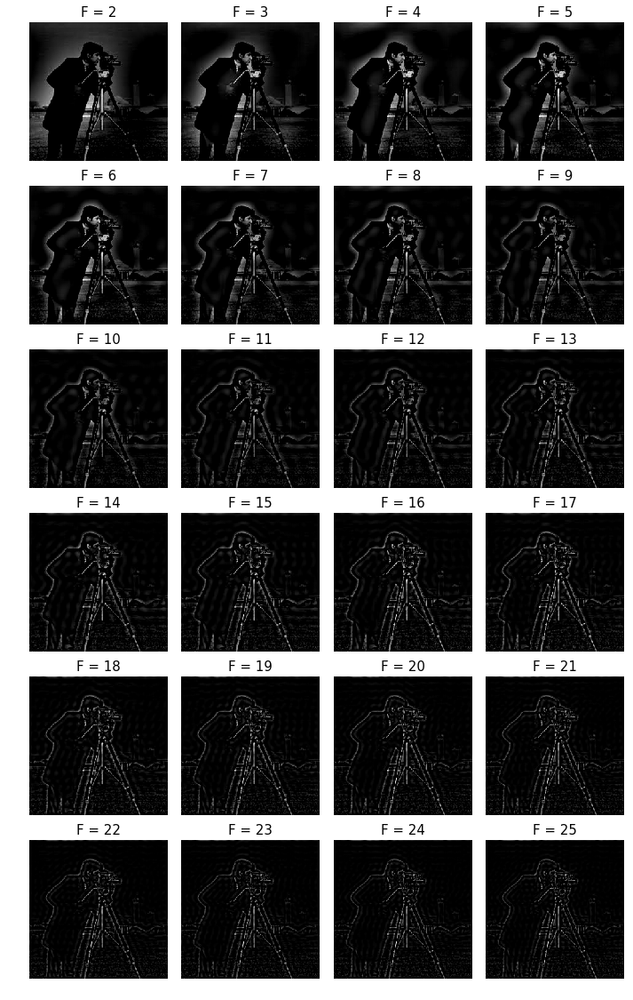

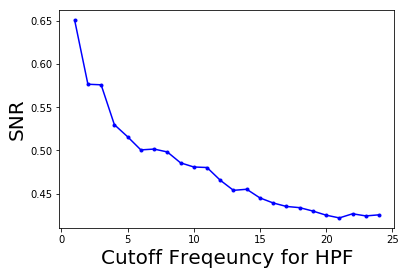

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:77: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


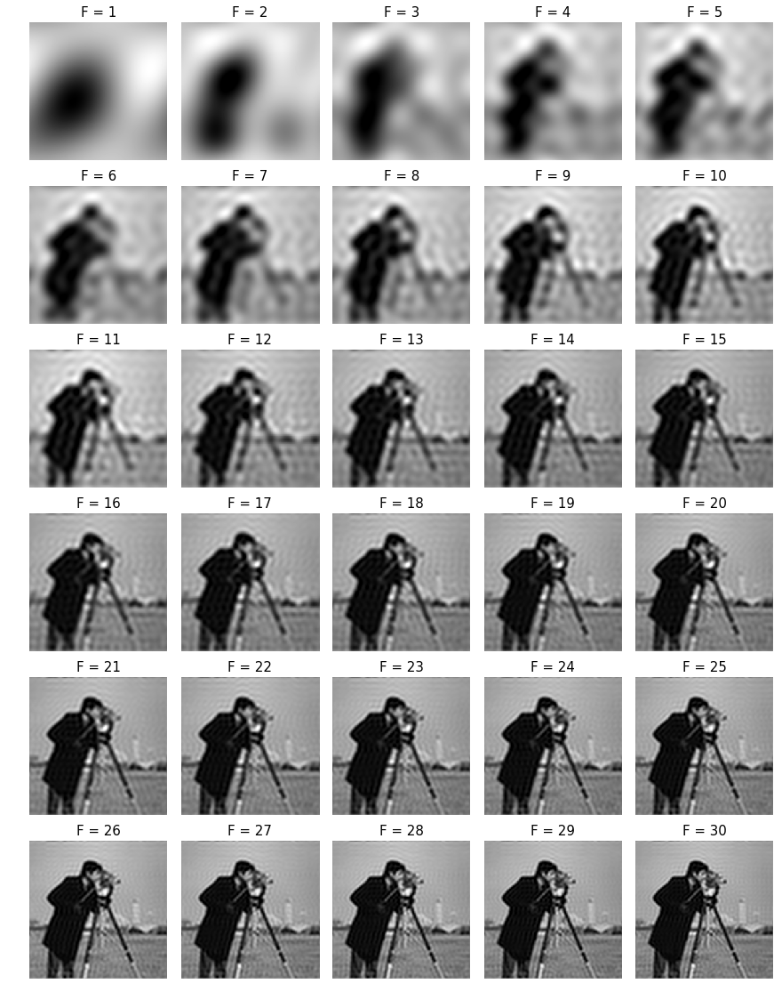

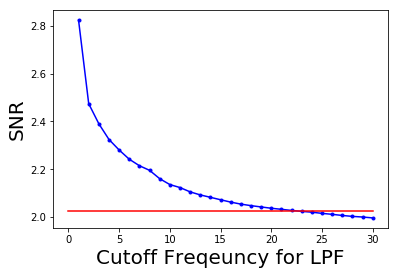

2.1429531716871146e-18


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:96: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


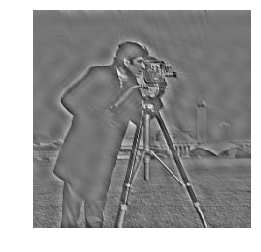

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:101: ComplexWarning: Casting complex values to real discards the imaginary part


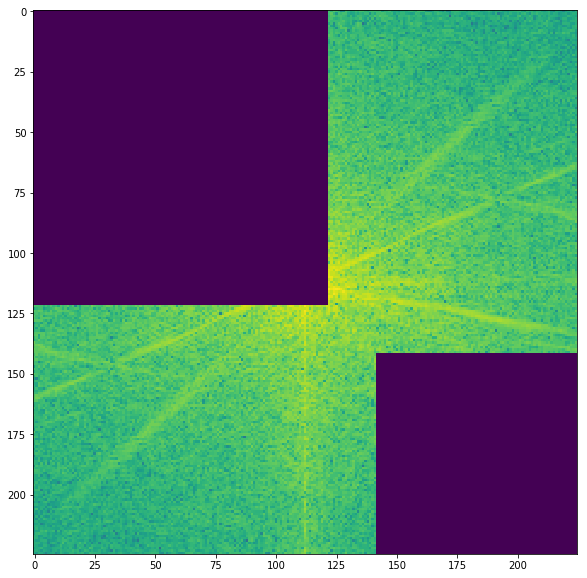

In [130]:
from scipy import fftpack

im = np.array(Image.open('../images/rhino.jpg').convert('L')) #
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)

# high pass filter

freq1 = np.copy(freq)
freq2 = fftpack.fftshift(freq1)
freq2[half_w-10:half_w+11,half_h-10:half_h+11] = 0 # select all but the first 20x20 (low) frequencies
im1 = np.clip(fp.ifft2(fftpack.ifftshift(freq2)).real,0,255)
print(signaltonoise(im1, axis=None))
plt.imshow(im1, cmap='gray')
plt.axis('off')
plt.show()
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + freq2)).astype(int))
plt.show()

# low pass filter
freq1 = np.copy(freq)
freq2 = fftpack.fftshift(freq1)
freq2_low = np.copy(freq2)
freq2_low[half_w-10:half_w+11,half_h-10:half_h+11] = 0
freq2 -= freq2_low # select only the first 20x20 (low) frequencies
im1 = np.clip(fp.ifft2(fftpack.ifftshift(freq2)).real,0,255)
print(signaltonoise(im1, axis=None))
plt.imshow(im1, cmap='gray')
plt.axis('off')
plt.show()
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + freq2)).astype(int))
plt.show()


im = np.array(Image.open('../images/cameraman.jpg').convert('L')) #rhino
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)

# high pass filter
snrs_hp = []
lbs = list(range(1,25))
plt.figure(figsize=(12,20))
for l in lbs:
    freq1 = np.copy(freq)
    freq2 = fftpack.fftshift(freq1)
    freq2[half_w-l:half_w+l+1,half_h-l:half_h+l+1] = 0 # select all but the first lxl (low) frequencies
    im1 = np.clip(fp.ifft2(fftpack.ifftshift(freq2)).real,0,255)
    snrs_hp.append(signaltonoise(im1, axis=None))
    plt.subplot(6,4,l)
    plt.imshow(im1, cmap='gray')
    plt.axis('off')
    plt.title('F = ' + str(l+1), size=15)
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

plt.plot(lbs, snrs_hp, 'b.-')
#plt.plot(range(50), [snr]*50, 'r-')
plt.xlabel('Cutoff Freqeuncy for HPF', size=20)
plt.ylabel('SNR', size=20)
plt.show()

# low pass filter
snrs_lp = []
ubs = list(range(1,31))
plt.figure(figsize=(15,20))
for u in ubs:
    freq1 = np.copy(freq)
    freq2 = fftpack.fftshift(freq1)
    freq2_low = np.copy(freq2)
    freq2_low[half_w-u:half_w+u+1,half_h-u:half_h+u+1] = 0
    freq2 -= freq2_low # select only the first 20x20 (low) frequencies
    im1 = np.clip(fp.ifft2(fftpack.ifftshift(freq2)).real,0,255)
    snrs_lp.append(signaltonoise(im1, axis=None))
    plt.subplot(6,5,u)
    plt.imshow(im1, cmap='gray')
    plt.axis('off')
    plt.title('F = ' + str(u), size=15)
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

plt.plot(ubs, snrs_lp, 'b.-')
plt.plot(range(31), [snr]*31, 'r-')
plt.xlabel('Cutoff Freqeuncy for LPF', size=20)
plt.ylabel('SNR', size=20)
plt.show()

# band pass filter
freq1 = np.copy(freq)
freq2 = fftpack.fftshift(freq1)
freq2[:half_w+10,:half_h+10] = freq2[half_w+30:,half_h+30:] = 0 # select only the middle 20x20 (low) frequencies
im1 = fp.ifft2(fftpack.ifftshift(freq2)).real
print(signaltonoise(im1, axis=None))
plt.imshow(im1, cmap='gray')
plt.axis('off')
plt.show()
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + freq2)).astype(int))
plt.show()

#print(freq.shape)

## Helper functions to rescale a frequency-image to [0, 255] and save
#remmax = lambda x: x/x.max()
#remmin = lambda x: x - np.amin(x, axis=(0,1), keepdims=True)
#touint8 = lambda x: (remmax(remmin(x))*(256-1e-4)).astype(int)

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:6: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:12: ComplexWarning: Casting complex values to real discards the imaginary part


3.2435673945845807


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:27: ComplexWarning: Casting complex values to real discards the imaginary part


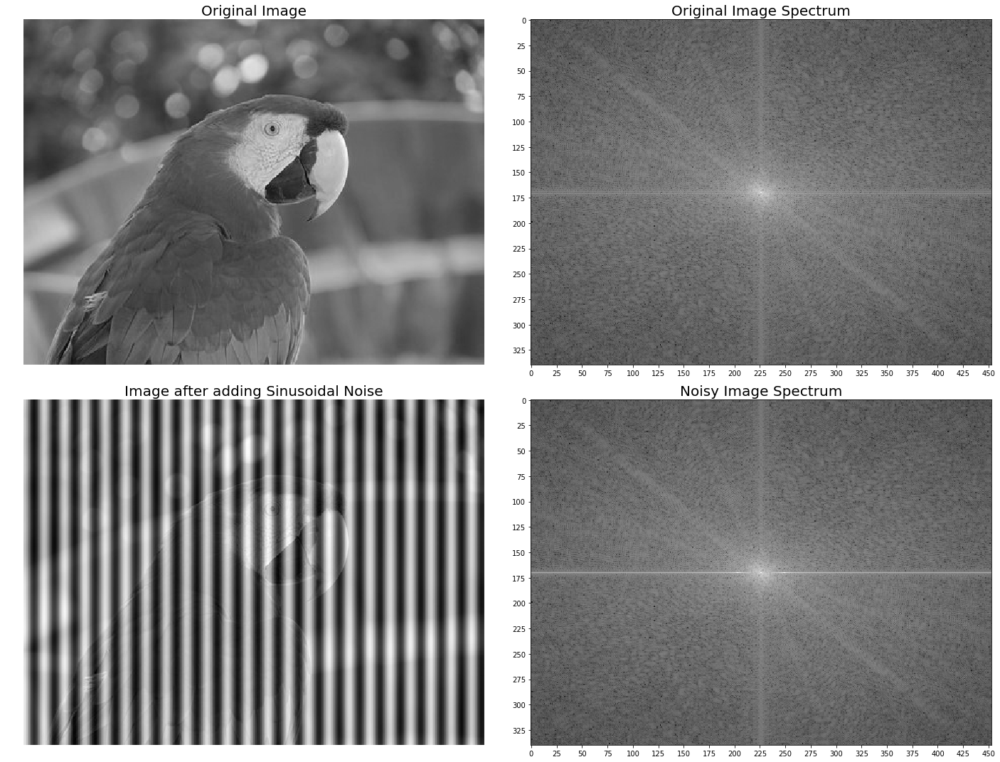

In [38]:
plt.figure(figsize=(20,15))
im =  np.mean(imread("../new images/parrot.png"), axis=2) / 255

plt.subplot(2,2,1) 
plt.imshow(im, cmap='gray')
print(signaltonoise(im, axis=None))
plt.axis('off')
plt.title('Original Image', size=20)
F1 = fp.fft2((im).astype(float))
F2 = fp.fftshift( F1 )
plt.subplot(2,2,2) 
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.xticks(np.arange(0, im.shape[1], 25))
plt.yticks(np.arange(0, im.shape[0], 25))
plt.title('Original Image Spectrum', size=20)

for n in range(im.shape[1]):
    im[:, n] += np.cos(0.1*np.pi*n)
    
plt.subplot(2,2,3) 
plt.imshow(im, cmap='gray')
plt.axis('off')
plt.title('Image after adding Sinusoidal Noise', size=20)
F1 = fp.fft2((im).astype(float))
F2 = fp.fftshift( F1 )
plt.subplot(2,2,4) 
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.xticks(np.arange(0, im.shape[1], 25))
plt.yticks(np.arange(0, im.shape[0], 25))
plt.title('Noisy Image Spectrum', size=20)
plt.tight_layout()
plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:5: ComplexWarning: Casting complex values to real discards the imaginary part


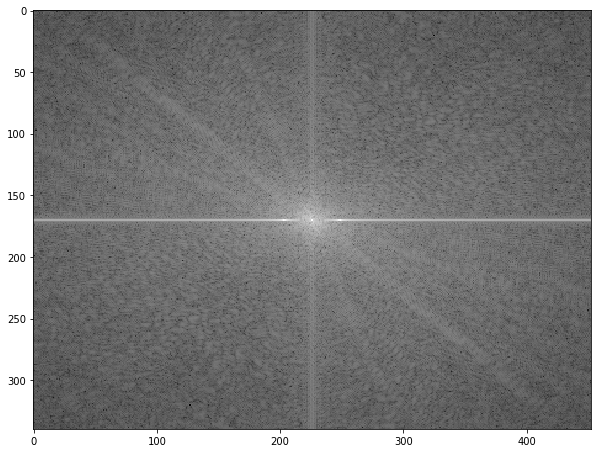

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:8: ComplexWarning: Casting complex values to real discards the imaginary part


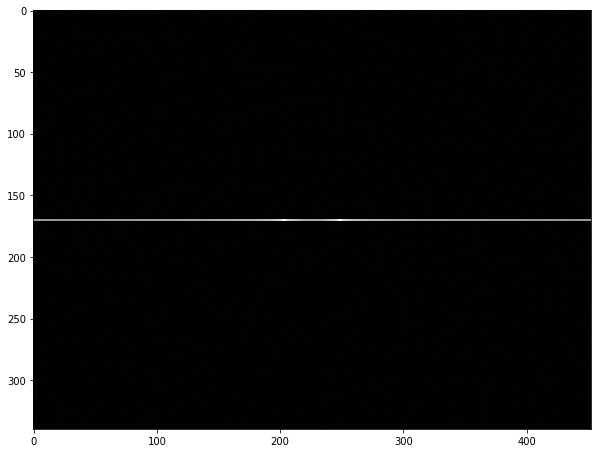

3.557354729839213


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:14: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


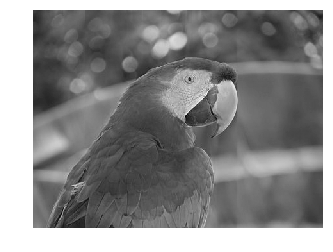

In [39]:
im =  np.mean(imread("../new images/parrot.png"), axis=2) / 255
F1o = fp.fft2((im).astype(float))
F2o = fp.fftshift( F1o )
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.show()
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + F2-F2o)).astype(int), cmap=plt.cm.gray)
plt.show()
#print(np.where(F2-F2o > 0))
F2[170:176,:220] = F2[170:176,230:] = 0
F1b = fp.ifftshift( F2 )
im1 =  fp.ifft2(F1b).real #np.abs()
print(signaltonoise(im1, axis=None))
#freq[:,int(0.1*np.pi)] = freq[:,int(np.pi-0.1*np.pi)] = 0
#im = freq2im(freq)
plt.axis('off')
plt.imshow(im1, cmap='gray')
plt.show()

(540, 720)


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\matplotlib\figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


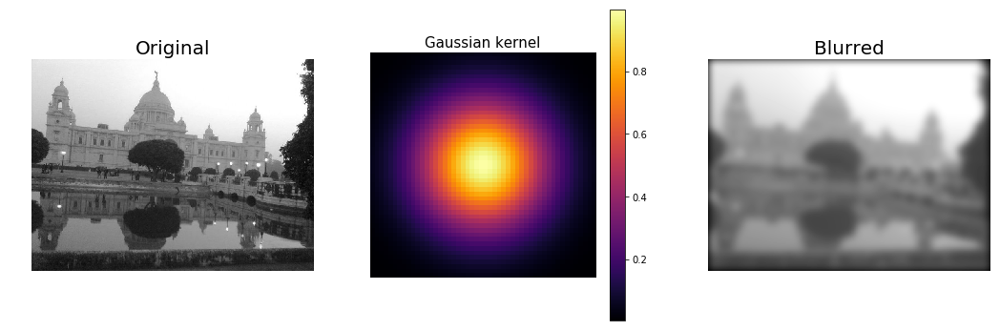

In [199]:
% matplotlib inline
from scipy import misc, signal
im = np.mean(misc.imread('../images/vic.png'), axis=2) #np.mean(misc.face(), axis=2)
print(im.shape)
kernel = np.outer(signal.gaussian(50, 10), signal.gaussian(50, 10))
im_blurred = signal.fftconvolve(im, kernel, mode='same')

fig, (ax_orig, ax_kernel, ax_blurred) = plt.subplots(1, 3, figsize=(18,6))
ax_orig.imshow(im, cmap='gray')
ax_orig.set_title('Original', size=20)
ax_orig.set_axis_off()
ims = ax_kernel.imshow(kernel, cmap=plt.cm.inferno) #, cmap='gray')
ax_kernel.set_title('Gaussian kernel', size=15)
ax_kernel.set_axis_off()
fig.colorbar(ims, ax=ax_kernel)
ax_blurred.imshow(im_blurred, cmap='gray')
ax_blurred.set_title('Blurred', size=20)
ax_blurred.set_axis_off()
fig.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:10: ComplexWarning: Casting complex values to real discards the imaginary part


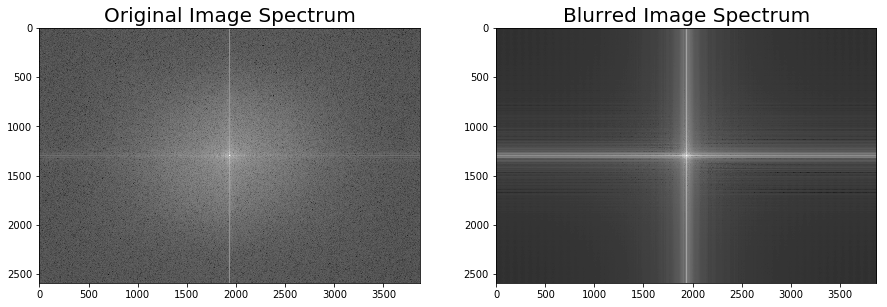

In [198]:
F1 = fftpack.fft2((im).astype(float))
F2 = fftpack.fftshift( F1 )
plt.figure(figsize=(15,8))
plt.subplot(1,2,1)
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.title('Original Image Spectrum', size=20)
F1 = fftpack.fft2((im_blurred).astype(float))
F2 = fftpack.fftshift( F1 )
plt.subplot(1,2,2)
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.title('Blurred Image Spectrum', size=20)
plt.show()

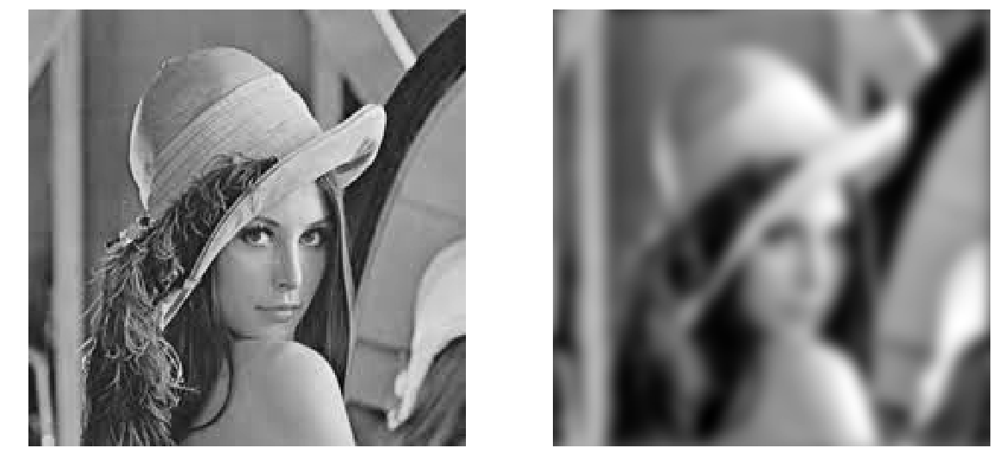

In [206]:
from scipy import ndimage, misc
import numpy.fft
import matplotlib.pyplot as plt
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
plt.gray()  # show the filtered result in grayscale
lena = np.mean(imread('../images/lena.jpg'), axis=2)
input_ = numpy.fft.fft2(lena)
result = ndimage.fourier_gaussian(input_, sigma=4)
result = numpy.fft.ifft2(result)
ax1.imshow(lena)
ax2.imshow(result.real)  # the imaginary part is an artifact
ax1.axis('off')
ax2.axis('off')
plt.show()

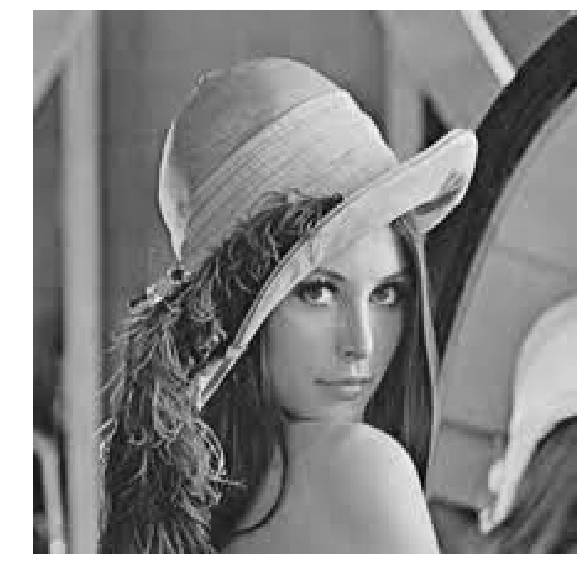

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:16: ComplexWarning: Casting complex values to real discards the imaginary part


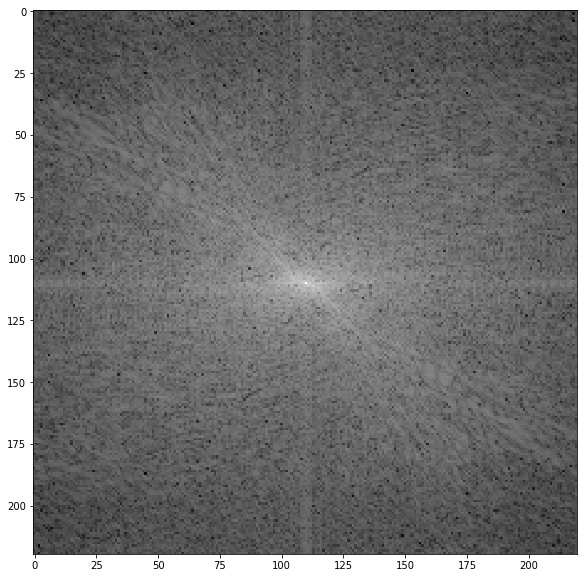

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:26: ComplexWarning: Casting complex values to real discards the imaginary part


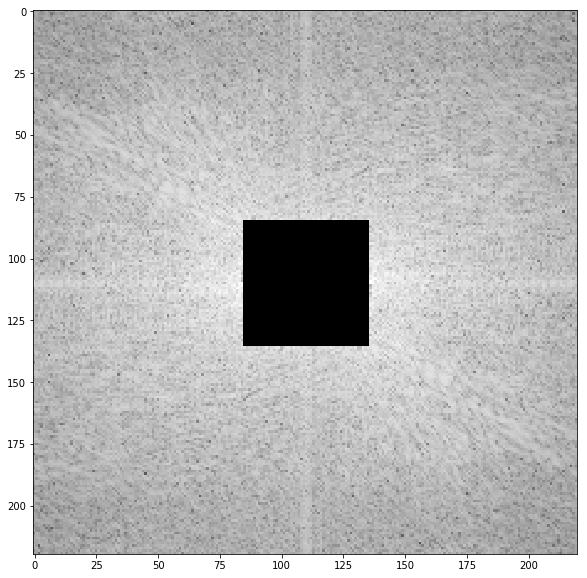

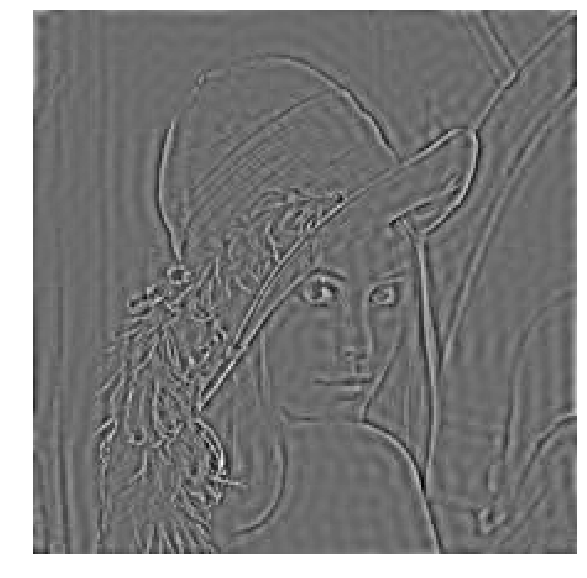

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:36: ComplexWarning: Casting complex values to real discards the imaginary part


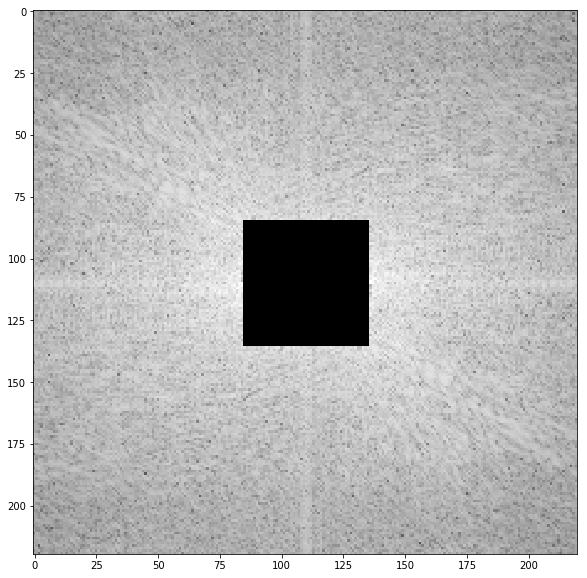

In [220]:
from skimage.io import imread
import matplotlib.pyplot as plt
import numpy as np
import scipy.fftpack as fp

# Load the data...
im = np.mean(imread('../images/lena.jpg'), axis=2)
plt.figure(figsize=(10,10))
plt.imshow(im, cmap=plt.cm.gray)
plt.axis('off')
plt.show()

F1 = fftpack.fft2((im).astype(float))
F2 = fftpack.fftshift(F1)
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.show()

(w, h) = im.shape
half_w, half_h = int(w/2), int(h/2)

# high pass filter
n = 25
F2[half_w-n:half_w+n+1,half_h-n:half_h+n+1] = 0 # select all but the first 50x50 (low) frequencies
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int))
plt.show()

im1 = fp.ifft2(fftpack.ifftshift(F2)).real
plt.figure(figsize=(10,10))
plt.imshow(im1, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int))
plt.show()

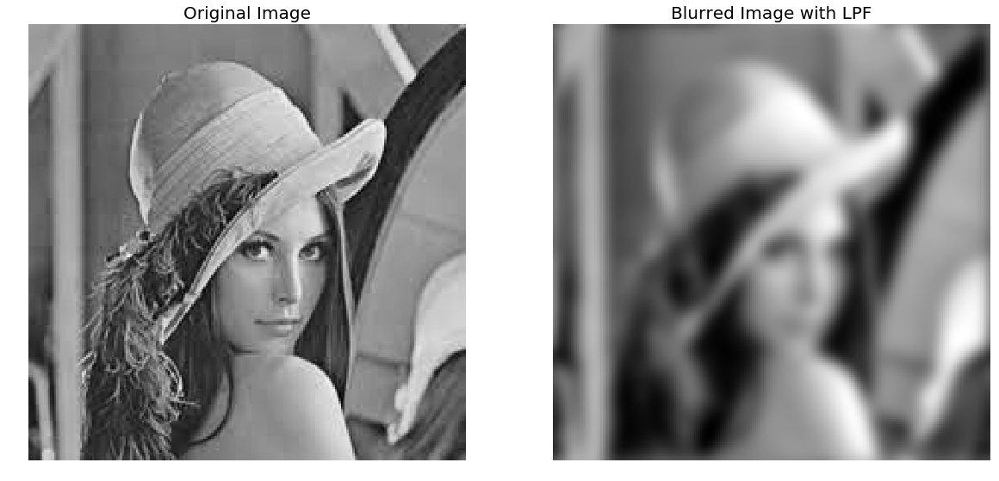

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:19: ComplexWarning: Casting complex values to real discards the imaginary part


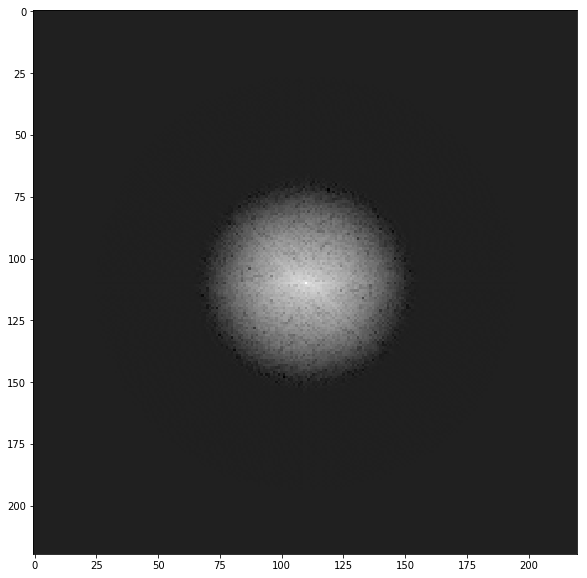

In [232]:
from scipy import ndimage, misc
import numpy.fft
import matplotlib.pyplot as plt
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
plt.gray()  # show the filtered result in grayscale
im = np.mean(imread('../images/lena.jpg'), axis=2)
input_ = numpy.fft.fft2(im)
#result1 = ndimage.fourier_ellipsoid(input_, size=10) #ndimage.fourier_uniform(input_, size=10)
result1 = ndimage.fourier_gaussian(input_, sigma=4) # ndimage.fourier_uniform(input_, size=10)
result = numpy.fft.ifft2(result1)
ax1.imshow(im)
ax1.axis('off')
ax1.set_title('Original Image', size=20)
ax2.imshow(result.real)  # the imaginary part is an artifact
ax2.axis('off')
ax2.set_title('Blurred Image with LPF', size=20)
plt.show()
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + numpy.fft.fftshift(result1))).astype(int))
plt.show()

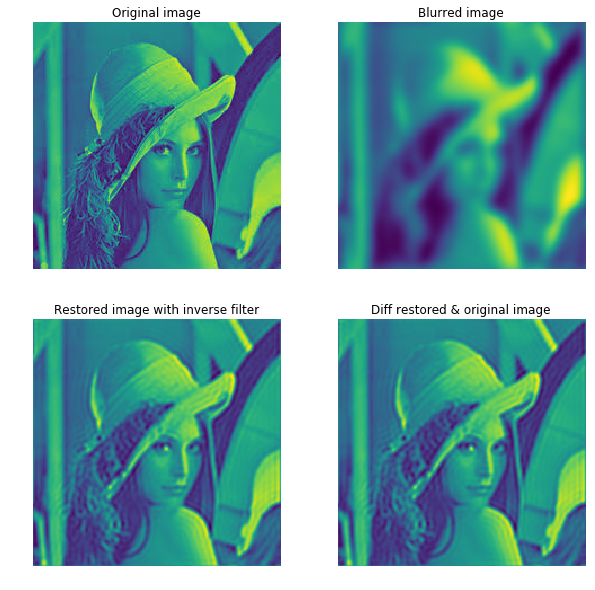

In [193]:
epsilon = 10**-6

#im = rgb2gray(imread('../images/lena.jpg'))
#im_blur = imread('../new images/lena_gauss_blur.jpg')
#freq_kernel = imread('../new images/freq_gauss_kernel.jpg')

freq = fp.fft2(im_blur)
freq_kernel =  1 / (epsilon + freq_kernel)

#freq_kernel =  1 / freq_kernel
#freq_kernel[np.isnan(freq_kernel)] = 0
#freq_kernel[freq_kernel<epsilon] = 0
#freq_kernel[freq_kernel>=epsilon] = 1/freq_kernel[freq_kernel>=epsilon]

convolved = freq*freq_kernel
im_restored = fp.ifft2(convolved).real
im_restored = 255 * im_restored / np.max(im_restored)

#print(np.max(im), np.max(im_blur), im_blur.shape, np.max(im_restored))

plt.figure(figsize=(10,10))
plt.subplot(221)
plt.imshow(im)
plt.title('Original image')
plt.axis('off')
plt.subplot(222)
plt.imshow(im_blur)
plt.title('Blurred image')
plt.axis('off')
plt.subplot(223)
plt.imshow(im_restored)
plt.title('Restored image with inverse filter')
plt.axis('off')
plt.subplot(224)
plt.imshow(im_restored - im)
plt.title('Diff restored & original image')
plt.axis('off')
plt.show()

In [ ]:
fig = plt.figure(figsize=(8,8))
epsilon = 10**-6
ax = fig.gca(projection='3d')
X = np.arange(-freq.shape[0]//2,freq.shape[0]-freq.shape[0]//2)
Y = np.arange(-freq.shape[1]//2,freq.shape[1]-freq.shape[1]//2)
X, Y = np.meshgrid(X, Y)
#Z = np.absolute(fp.fftshift(freq_kernel))#.real
Z = (20*np.log10( 0.01 + fp.fftshift(freq))).real
#Z = 1 / (epsilon + Z)
#Z[Z<epsilon] = 0
#Z[Z>=epsilon] = 1/Z[Z>=epsilon]
# Plot the surface.
colors = cm.coolwarm(Z)

# Plot the surface.
surf = ax.plot_surface(X, Y, Z,  cmap=cm.coolwarm, linewidth=0, antialiased=False) 
#ax.plot_wireframe(X, Y, Z, rstride=10, cstride=10)

#surf = ax.plot_surface(X, Y, Z,  facecolors=colors, rstride=30, cstride=30) #
#surf.set_facecolor((0,0,0,0))
#surf = ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
#                       linewidth=0, antialiased=False)
#ax.set_zscale("log", nonposx='clip')
#ax.zaxis.set_scale('log')
ax.zaxis.set_major_locator(LinearLocator(10))
ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))
# Add a color bar which maps values to colors.
fig.colorbar(surf, ax, shrink=0.5, aspect=5)
plt.show()

255.0


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:34: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:38: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:41: ComplexWarning: Casting complex values to real discards the imaginary part


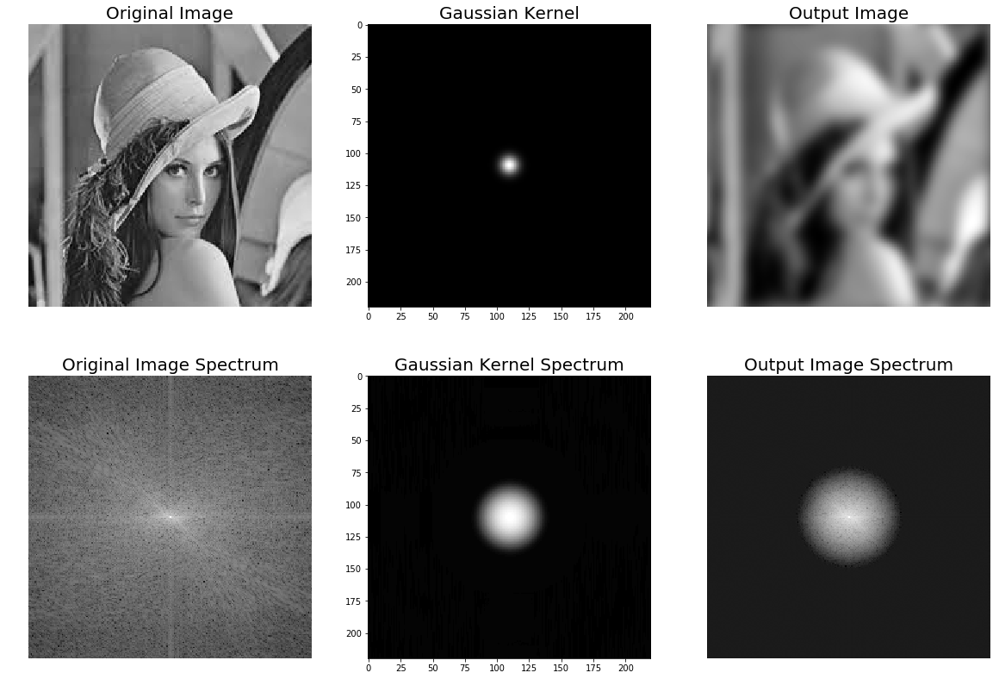

In [387]:
from scipy import signal
import numpy.fft as fp
import matplotlib.pyplot as plt

plt.figure(figsize=(20,15))
plt.gray() # show the filtered result in grayscale

#im = np.mean(imread('../images/lena.jpg'), axis=2)
im = rgb2gray(imread('../images/lena.jpg'))
kernel = np.outer(signal.gaussian(im.shape[0], 5), signal.gaussian(im.shape[1], 5))

freq = fp.fft2(im)
assert(freq.shape == kernel.shape)
freq_kernel = fp.fft2(fp.ifftshift(kernel))
convolved = freq*freq_kernel
im1 = fp.ifft2(convolved).real
im1 = 255 * im1 / np.max(im1)
#im1 = np.clip(fp.ifft2(convolved).real, 0, 255).astype(np.uint8)
print(np.max(im1))
#im1 = signal.fftconvolve(im, kernel, mode='same')  # output blurred image

plt.subplot(2,3,1)
plt.imshow(im)
plt.title('Original Image', size=20)
plt.axis('off')
plt.subplot(2,3,2)
plt.imshow(kernel)
plt.title('Gaussian Kernel', size=20)
plt.subplot(2,3,3)
plt.imshow(im1) # the imaginary part is an artifact
plt.title('Output Image', size=20)
plt.axis('off')
plt.subplot(2,3,4)
plt.imshow( (20*np.log10( 0.1 + fp.fftshift(freq))).astype(int))
plt.title('Original Image Spectrum', size=20)
plt.axis('off')
plt.subplot(2,3,5)
plt.imshow( (20*np.log10( 0.1 + fp.fftshift(freq_kernel))).astype(int))
plt.title('Gaussian Kernel Spectrum', size=20)
plt.subplot(2,3,6)
plt.imshow( (20*np.log10( 0.1 + fp.fftshift(convolved))).astype(int))
plt.title('Original Image Spectrum', size=20)
plt.title('Output Image Spectrum', size=20)
plt.axis('off')
plt.subplots_adjust(wspace=0.2, hspace=0)
plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:6: ComplexWarning: Casting complex values to real discards the imaginary part


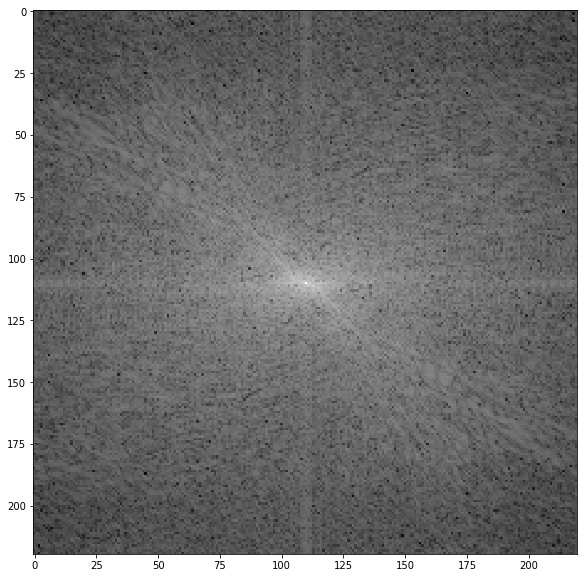

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:9: ComplexWarning: Casting complex values to real discards the imaginary part


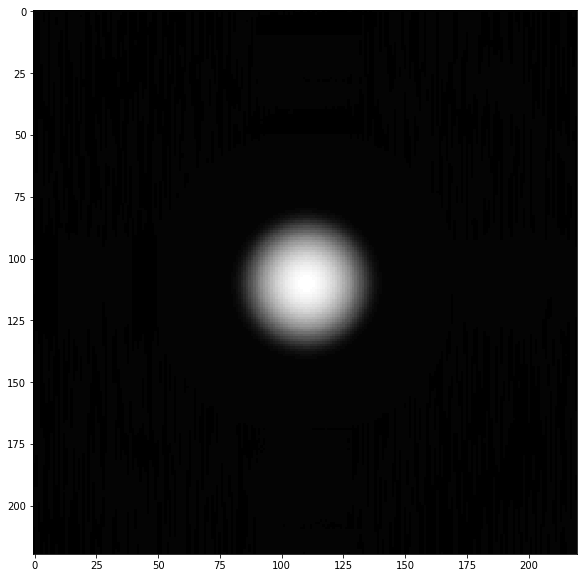

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:12: ComplexWarning: Casting complex values to real discards the imaginary part


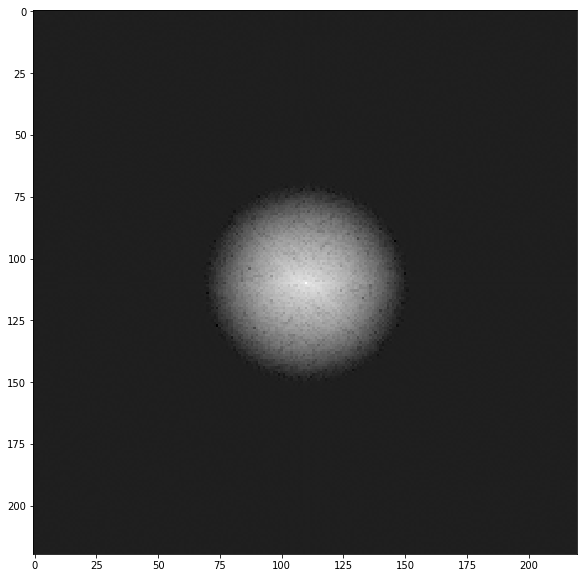

In [375]:
freq = numpy.fft.fft2(im)
freq_kernel = numpy.fft.fft2(numpy.fft.ifftshift(kernel))
convolved = freq*freq_kernel
im1 = numpy.fft.ifft2(convolved).real
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + numpy.fft.fftshift(freq))).astype(int))
plt.show()
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + numpy.fft.fftshift(freq_kernel))).astype(int))
plt.show()
plt.figure(figsize=(10,10))
plt.imshow( (20*np.log10( 0.1 + numpy.fft.fftshift(convolved))).astype(int))
plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:11: DeprecationWarning: `signaltonoise` is deprecated!
scipy.stats.signaltonoise is deprecated in scipy 0.16.0


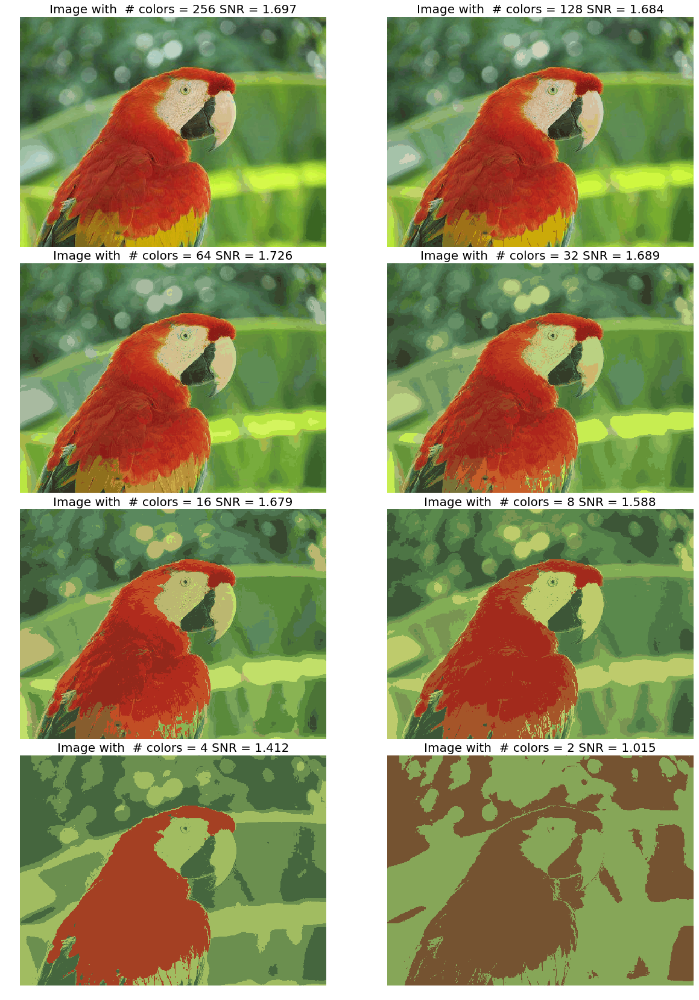

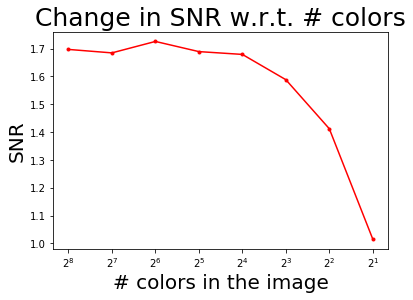

In [20]:
im = Image.open('../new images/parrot.jpg')
plt.figure(figsize=(20,30))
num_colors_list = [1 << n for n in range(8,0,-1)]
snr_list = []
i = 1
for num_colors in num_colors_list:
    im1 = im.convert('P', palette=Image.ADAPTIVE, colors=num_colors)
    plt.subplot(4,2,i)
    plt.imshow(im1)
    plt.axis('off')
    snr_list.append(signaltonoise(im1, axis=None))
    plt.title('Image with  # colors = ' + str(num_colors) + ' SNR = ' + str(np.round(snr_list[i-1],3)), size=20)
    i += 1
plt.subplots_adjust(wspace=0.2, hspace=0)
plt.show()

plt.plot(num_colors_list, snr_list, 'r.-')
plt.xlabel('# colors in the image', size=20)
plt.ylabel('SNR', size=20)
plt.title('Change in SNR w.r.t. # colors', size=25)
plt.xscale('log', basex=2)
plt.gca().invert_xaxis()
plt.show()

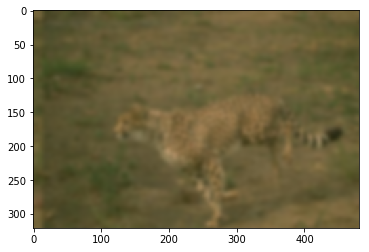

In [422]:
img = plt.imread('../images/cheetah.png')

# prepare an 1-D Gaussian convolution kernel
t = np.linspace(-10, 10, 30)
bump = np.exp(-0.1*t**2)
bump /= np.trapz(bump) # normalize the integral to 1
# make a 2-D kernel out of it
kernel = bump[:,np.newaxis] * bump[np.newaxis,:]

# padded fourier transform, with the same shape as the image
kernel_ft = np.fft.fft2(kernel, s=img.shape[:2], axes=(0, 1))

# convolve
img_ft = np.fft.fft2(img, axes=(0, 1))
img2_ft = kernel_ft[:,:,np.newaxis] * img_ft
img2 = np.fft.ifft2(img2_ft, axes=(0, 1)).real

# clip values to range
img2 = np.clip(img2, 0, 1)


# plot output
plt.imshow(img2)


In [ ]:
from scipy import misc, signal
im = np.mean(misc.imread('../images/lena.jpg'), axis=2) 
print(im.shape)
kernel = np.outer(signal.gaussian(9, 2), signal.gaussian(9, 2)) # 2D Gaussian kernel with σ = 8

im_blurred_freq = signal.fftconvolve(im, kernel, mode='same')
fig, (ax_orig, ax_kernel, ax_blurred) = plt.subplots(1, 3, figsize=(20,8))
ax_orig.imshow(im, cmap='gray')
ax_orig.set_title('Original', size=20)
ax_orig.set_axis_off()
ax_kernel.imshow(kernel) #, cmap='gray')
ax_kernel.set_title('Gaussian kernel', size=15)
ax_kernel.set_axis_off()
ax_blurred.imshow(im_blurred, cmap='gray')
ax_blurred.set_title('Blurred', size=20)
ax_blurred.set_axis_off()
fig.show()

(224, 225)


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\matplotlib\figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


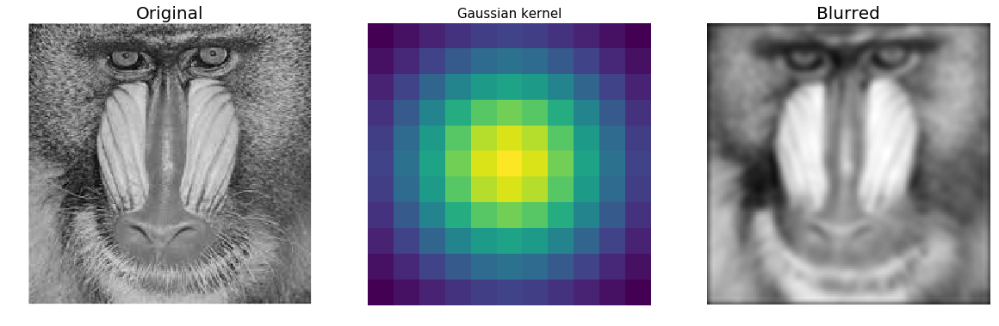

In [440]:
from scipy import misc, signal
im = np.mean(misc.imread('../images/mandrill.jpg'), axis=2) 
print(im.shape)
# (224, 225)
kernel = np.outer(signal.gaussian(11, 3), signal.gaussian(11, 3)) # 2D Gaussian kernel of size 11x11 with σ = 3
im_blurred = signal.fftconvolve(im, kernel, mode='same')
fig, (ax_orig, ax_kernel, ax_blurred) = plt.subplots(1, 3, figsize=(20,8))
ax_orig.imshow(im, cmap='gray')
ax_orig.set_title('Original', size=20)
ax_orig.set_axis_off()
ax_kernel.imshow(kernel, cmap='viridis')
ax_kernel.set_title('Gaussian kernel', size=15)
ax_kernel.set_axis_off()
ax_blurred.imshow(im_blurred, cmap='gray')
ax_blurred.set_title('Blurred', size=20)
ax_blurred.set_axis_off()
fig.show()

In [454]:
from scipy import misc, signal
import timeit
im = np.mean(misc.imread('../images/mandrill.jpg'), axis=2) 
print(im.shape)
# (224, 225)
kernel = np.outer(signal.gaussian(11, 3), signal.gaussian(11, 3)) # 2D Gaussian kernel of size 11x11 with σ = 3
im_blurred1 = signal.convolve(im, kernel, mode="same")
im_blurred2 = signal.fftconvolve(im, kernel, mode='same')
def wrapper_convolve(func):
    def wrapped_convolve():
        return func(im, kernel, mode="same")
    return wrapped_convolve
wrapped_convolve = wrapper_convolve(signal.convolve)
wrapped_fftconvolve = wrapper_convolve(signal.fftconvolve)
times1 = timeit.repeat(wrapped_convolve, number=1, repeat=100)
times2 = timeit.repeat(wrapped_fftconvolve, number=1, repeat=100)

(224, 225)


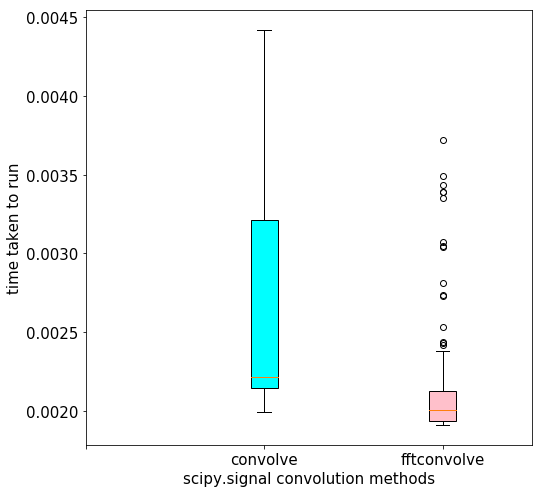

In [490]:
data = [times1, times2]
plt.figure(figsize=(8,8))
box = plt.boxplot(data, patch_artist=True) #notch=True, 
colors = ['cyan', 'pink'] #'lightblue', 'lightgreen', 'tan', 
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #patch.set_edgecolor(color)
plt.xticks(np.arange(3), ('', 'convolve', 'fftconvolve'), size=15) #, rotation=90
plt.yticks(fontsize=15)
plt.xlabel('scipy.signal convolution methods', size=15)
plt.ylabel('time taken to run', size = 15)
plt.show()

(-0.5, 224.5, 223.5, -0.5)

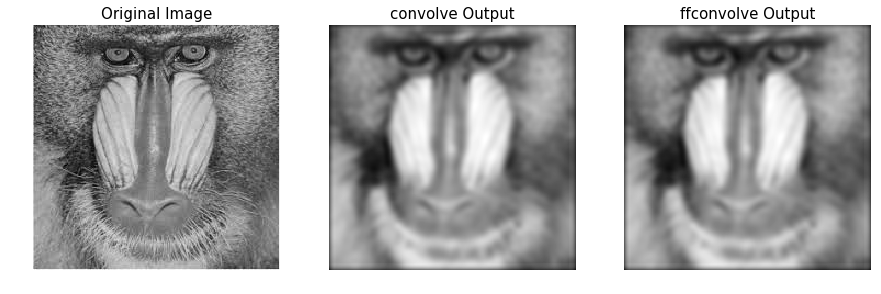

In [487]:
plt.figure(figsize=(15,5))
plt.gray()
plt.subplot(131)
plt.imshow(im)
plt.title('Original Image', size=15)
plt.axis('off')
plt.subplot(132)
plt.imshow(im_blurred1)
plt.title('convolve Output', size=15)
plt.axis('off')
plt.subplot(133)
plt.imshow(im_blurred2)
plt.title('ffconvolve Output', size=15)
plt.axis('off')

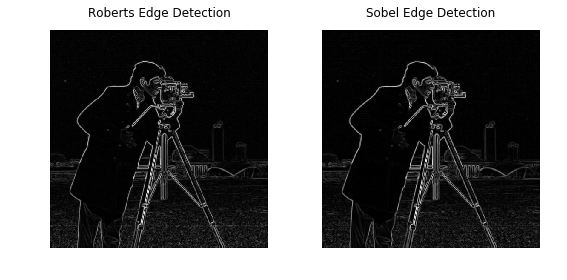

In [491]:
import numpy as np
import matplotlib.pyplot as plt

from skimage.data import camera
from skimage.filters import roberts, sobel, scharr, prewitt


image = camera()
edge_roberts = roberts(image)
edge_sobel = sobel(image)

fig, ax = plt.subplots(ncols=2, sharex=True, sharey=True,
                       figsize=(8, 4))

ax[0].imshow(edge_roberts, cmap=plt.cm.gray)
ax[0].set_title('Roberts Edge Detection')

ax[1].imshow(edge_sobel, cmap=plt.cm.gray)
ax[1].set_title('Sobel Edge Detection')

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

1.0
(225, 225)


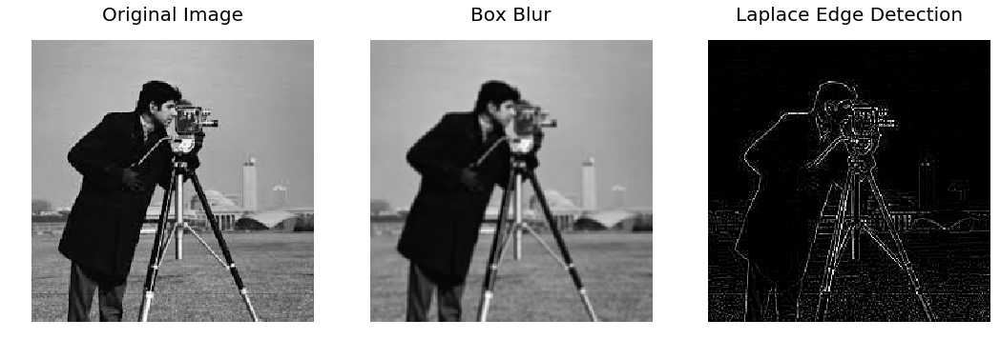

In [96]:
from scipy import misc, signal
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu

im = rgb2gray(imread('../images/cameraman.jpg')).astype(float)
print(np.max(im))
print(im.shape)

blur_box_kernel = np.ones((3,3)) / 9
edge_laplace_kernel = np.array([[0,1,0],[1,-4,1],[0,1,0]])

im_blurred = ndimage.convolve(im, blur_box_kernel)
im_edges = np.clip(ndimage.convolve(im, edge_laplace_kernel),0,1)
#im_edges[im_edges<0]=0
#im_edges = im_edges/(np.max(im_edges)-np.min(im_edges)) 
#thresh = threshold_otsu(im_edges)
#im_edges_binary = image > thresh

#print(im_blurred.shape, im_edges.shape, im_edges_binary.shape)

fig, ax = plt.subplots(ncols=3, sharex=True, sharey=True, figsize=(18, 6))
#plt.setp(ax.flat, aspect=1.0, adjustable='box-forced')


ax[0].imshow(im, cmap=plt.cm.gray)
ax[0].set_title('Original Image', size=20)

ax[1].imshow(im_blurred, cmap=plt.cm.gray)
ax[1].set_title('Box Blur', size=20)

ax[2].imshow(im_edges, cmap=plt.cm.gray)
ax[2].set_title('Laplace Edge Detection', size=20)

for a in ax:
    a.axis('off')
    
#plt.subplots_adjust(wspace=0.1, hspace=0.1)

#plt.tight_layout()
plt.show()

255.0


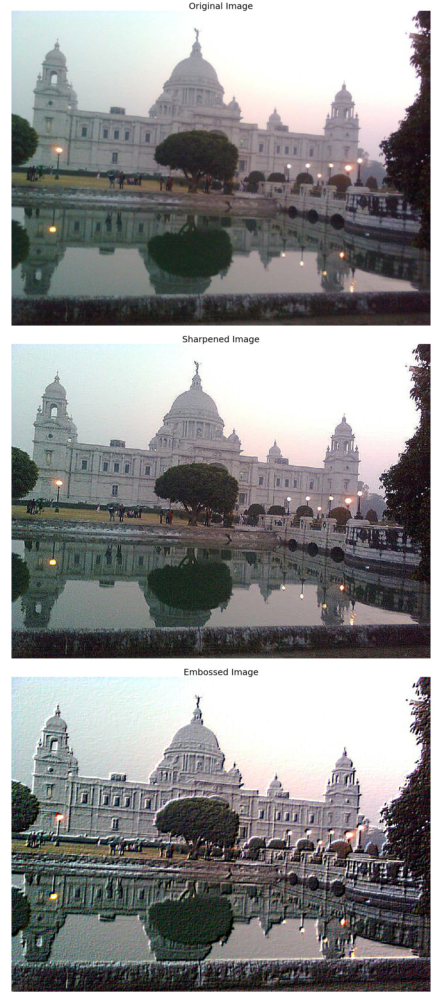

In [628]:
from PIL import Image

from scipy import ndimage, misc
import numpy as np

im = misc.imread('../images/vic.png').astype(np.float)  # read as float
print(np.max(im))
sharpen_kernel = np.array([0, -1, 0, -1, 5, -1, 0, -1, 0]).reshape((3, 3, 1))
emboss_kernel = np.array(np.array([[-2,-1,0],[-1,1,1],[0,1,2]])).reshape((3, 3, 1))

im_sharp = ndimage.convolve(im, sharpen_kernel, mode='nearest') # 
im_sharp = np.clip(im_sharp, 0, 255).astype(np.uint8) # clip (0 to 255) and convert to unsigned int

im_emboss = ndimage.convolve(im, emboss_kernel, mode='nearest') # 
im_emboss = np.clip(im_emboss, 0, 255).astype(np.uint8) 

plt.figure(figsize=(20,40))
plt.subplot(311)
plt.imshow(im.astype(np.uint8))
plt.axis('off')
plt.title('Original Image', size=25)
plt.subplot(312)
plt.imshow(im_sharp)
plt.axis('off')
plt.title('Sharpened Image', size=25)
plt.subplot(313)
plt.imshow(im_emboss)
plt.axis('off')
plt.title('Embossed Image', size=25)
plt.tight_layout()
plt.show()

In [ ]:
def padwithzeros(vector, pad_width, iaxis, kwargs):
    vector[:pad_width[0]] = 0
    vector[-pad_width[1]:] = 0
    return vector

im = rgb2gray(imread('../my images/madurga.jpg')) #/ 255
print(im.shape, np.max(im))
size = 21
kernel = np.zeros((size, size))
kernel[int((size-1)/2), :] = np.ones(size) #5*
kernel = kernel / size
print(kernel.shape)
kernel = np.pad(kernel, (((im.shape[0]-size)//2,(im.shape[0]-size)//2+1), ((im.shape[1]-size)//2,(im.shape[1]-size)//2+1)), padwithzeros)

print(kernel.shape, (im.shape[0]-size)//2, (im.shape[1]-size)//2)

freq1 = fp.fft2(im)
freq_kernel1 = fp.fft2(fp.ifftshift(kernel))
convolved1 = freq1*freq_kernel1
im_blur = fp.ifft2(convolved1).real
im_blur = 255 * im_blur / np.max(im_blur)
plt.imshow( (20*np.log10( 0.01 + fp.fftshift(freq_kernel1))).real.astype(int), cmap='coolwarm')
plt.colorbar()
plt.show()

plt.imshow(im_blur) #.astype(np.uint8))
plt.show()

epsilon = 10**-6

freq = fp.fft2(im_blur)
freq_kernel =  1 / (epsilon + freq_kernel1)

convolved = freq*freq_kernel
im_restored = fp.ifft2(convolved).real
im_restored = im_restored / np.max(im_restored)

plt.figure(figsize=(18,12))
plt.subplot(221)
plt.imshow(im)
plt.title('Original image', size=20)
plt.axis('off')
plt.subplot(222)
plt.imshow(im_blur)
plt.title('Blurred image with motion blur kernel', size=20)
plt.axis('off')
plt.subplot(223)
plt.imshow(im_restored)
plt.title('Restored image with inverse filter', size=20)
plt.axis('off')
plt.subplot(224)
plt.imshow(im_restored - im)
plt.title('Diff restored & original image', size=20)
plt.axis('off')
plt.show()

fig = plt.figure(figsize=(8,8))
ax = fig.gca(projection='3d')
Y = np.arange(-freq.shape[0]//2,freq.shape[0]-freq.shape[0]//2)
X = np.arange(-freq.shape[1]//2,freq.shape[1]-freq.shape[1]//2)
X, Y = np.meshgrid(X, Y)
#Z = (20*np.log10( 0.01 + fp.fftshift(freq_kernel))).real
#Z = np.absolute(fp.fftshift(freq_kernel))#.real
#Z = (20*np.log10( 0.01 + fp.fftshift(freq1))).real
Z = (20*np.log10( 0.01 + fp.fftshift(convolved))).real
print(X.shape, Y.shape, Z.shape)

# Plot the surface.
surf = ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)
#ax.set_zscale("log", nonposx='clip')
#ax.zaxis.set_scale('log')
ax.zaxis.set_major_locator(LinearLocator(10))
ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))
# Add a color bar which maps values to colors.
fig.colorbar(surf, ax, shrink=0.5, aspect=5)
plt.show()

In [ ]:
from skimage.util import random_noise
from skimage.color import rgb2gray
from scipy import signal

im = rgb2gray(imread('../images/lena.jpg')) #/ 255
im = random_noise(im, var=0.1)

print(im.shape, np.max(im))
kernel = np.outer(signal.gaussian(im.shape[0], 5), signal.gaussian(im.shape[1], 5))

plt.gray()
freq1 = fp.fft2(im)
freq_kernel1 = fp.fft2(fp.ifftshift(kernel))
convolved1 = freq1*freq_kernel1
im_blur = fp.ifft2(convolved1).real
im_blur = 255 * im_blur / np.max(im_blur)
plt.imshow( (20*np.log10( 0.01 + fp.fftshift(freq_kernel1))).real.astype(int), cmap='coolwarm')
plt.colorbar()
plt.show()

plt.imshow(im_blur) #.astype(np.uint8))
plt.show()

epsilon = 10**-6

freq = fp.fft2(im_blur)
freq_kernel =  1 / (epsilon + freq_kernel1)

convolved = freq*freq_kernel
im_restored = fp.ifft2(convolved).real
im_restored = im_restored / np.max(im_restored)

plt.figure(figsize=(12,12))
plt.subplot(221)
plt.imshow(im)
plt.title('Original image', size=20)
plt.axis('off')
plt.subplot(222)
plt.imshow(im_blur)
plt.title('Blurred image with motion blur kernel', size=20)
plt.axis('off')
plt.subplot(223)
plt.imshow(im_restored)
plt.title('Restored image with inverse filter', size=20)
plt.axis('off')
plt.subplot(224)
plt.imshow(im_restored - im)
plt.title('Diff restored & original image', size=20)
plt.axis('off')
plt.show()

fig = plt.figure(figsize=(10,10))
ax = fig.gca(projection='3d')
Y = np.arange(-freq.shape[0]//2,freq.shape[0]-freq.shape[0]//2)
X = np.arange(-freq.shape[1]//2,freq.shape[1]-freq.shape[1]//2)
X, Y = np.meshgrid(X, Y)
Z = (20*np.log10( 0.01 + fp.fftshift(freq_kernel))).real
#Z = np.absolute(fp.fftshift(freq_kernel))#.real
#Z = (20*np.log10( 0.01 + fp.fftshift(freq1))).real
#Z = (20*np.log10( 0.01 + fp.fftshift(convolved))).real
print(X.shape, Y.shape, Z.shape)

# Plot the surface.
surf = ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)
ax.plot_wireframe(X, Y, Z, rstride=10, cstride=10)
#ax.set_zscale("log", nonposx='clip')
#ax.zaxis.set_scale('log')
ax.zaxis.set_major_locator(LinearLocator(10))
ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))
# Add a color bar which maps values to colors.
fig.colorbar(surf, ax, shrink=0.5, aspect=5)
plt.show()

In [520]:
def padwithzeros(vector, pad_width, iaxis, kwargs):
    vector[:pad_width[0]] = 0
    vector[-pad_width[1]:] = 0
    return vector
a = np.arange(6)
a = a.reshape((2, 3))
print(a)
a = np.pad(a, ((20,20),(120,120)), padwithzeros)
print(a.shape)

[[0 1 2]
 [3 4 5]]
(42, 243)


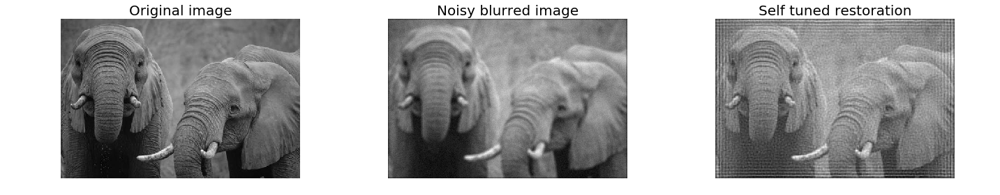

In [501]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import color, data, restoration

im = color.rgb2gray(imread('../new images/elephant_g.jpg'))
from scipy.signal import convolve2d as conv2
n = 7
psf = np.ones((n, n)) / n**2
im1 = conv2(im, psf, 'same')
im1 += 0.1 * astro.std() * np.random.standard_normal(im.shape)

im2, _ = restoration.unsupervised_wiener(im1, psf)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 4),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(im) #, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0].axis('off')
ax[0].set_title('Original image', size=20)

ax[1].imshow(im1) #, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[1].axis('off')
ax[1].set_title('Noisy blurred image', size=20)

ax[2].imshow(im2)
ax[2].axis('off')
ax[2].set_title('Self tuned restoration', size=20)

fig.tight_layout()

plt.show()

1.0
(1018, 1645, 3)


C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:20: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:20: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel\__main__.py:20: ComplexWarning: Casting complex values to real discards the imaginary part


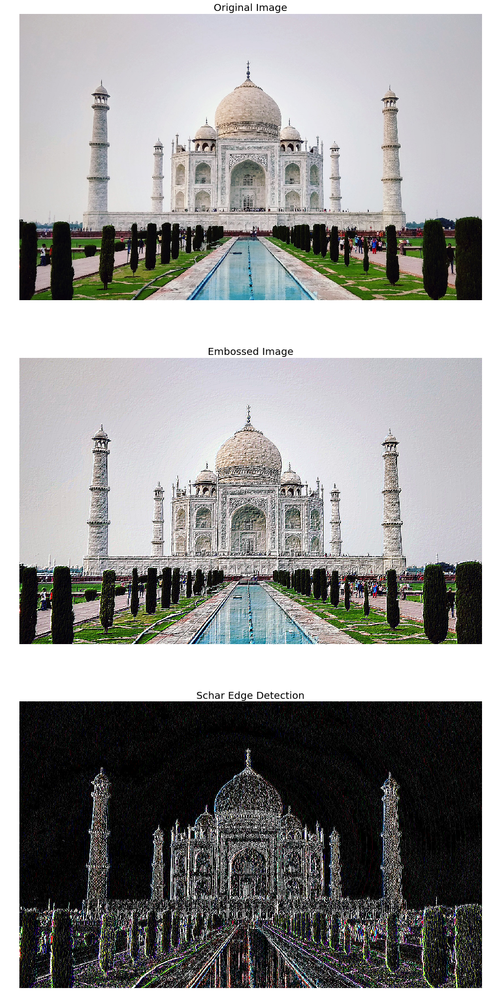

In [22]:
from scipy import misc, signal
from skimage.filters import threshold_otsu

#im = misc.imread('../images/tajmahal.jpg')/255 #np.mean(, axis=2) tajmahal
im = misc.imread('../new images/tajmahal.jpg')/255 #np.mean(, axis=2) tajmahal
print(np.max(im))
print(im.shape)

emboss_kernel = np.array([[-2,-1,0],[-1,1,1],[0,1,2]])
sharpen_kernel = np.array([[ -3-3j, 0-10j,  +3 -3j],
                    [-10+0j, 0+ 0j, +10 +0j],
                    [ -3+3j, 0+10j,  +3 +3j]])
im_embossed = np.ones(im.shape)
im_sharpened = np.ones(im.shape)

for i in range(3):
    im_embossed[...,i] = np.clip(signal.convolve2d(im[...,i], emboss_kernel, mode='same', boundary="symm"),0,1)

for i in range(3):
    im_sharpened[:,:,i] = np.clip(signal.convolve2d(im[...,i], sharpen_kernel, mode='same', boundary="symm"),0,1)

fig, ax = plt.subplots(nrows=3, figsize=(20, 36))
#plt.setp(ax.flat, aspect=1.0, adjustable='box-forced')

ax[0].imshow(im)
ax[0].set_title('Original Image', size=20)

ax[1].imshow(im_embossed)
ax[1].set_title('Embossed Image', size=20)

ax[2].imshow(im_sharpened)
ax[2].set_title('Schar Edge Detection', size=20)

for a in ax:
    a.axis('off')
    
#plt.subplots_adjust(wspace=0.1, hspace=0.1)

#plt.tight_layout()
plt.show()

236
(252, 281)


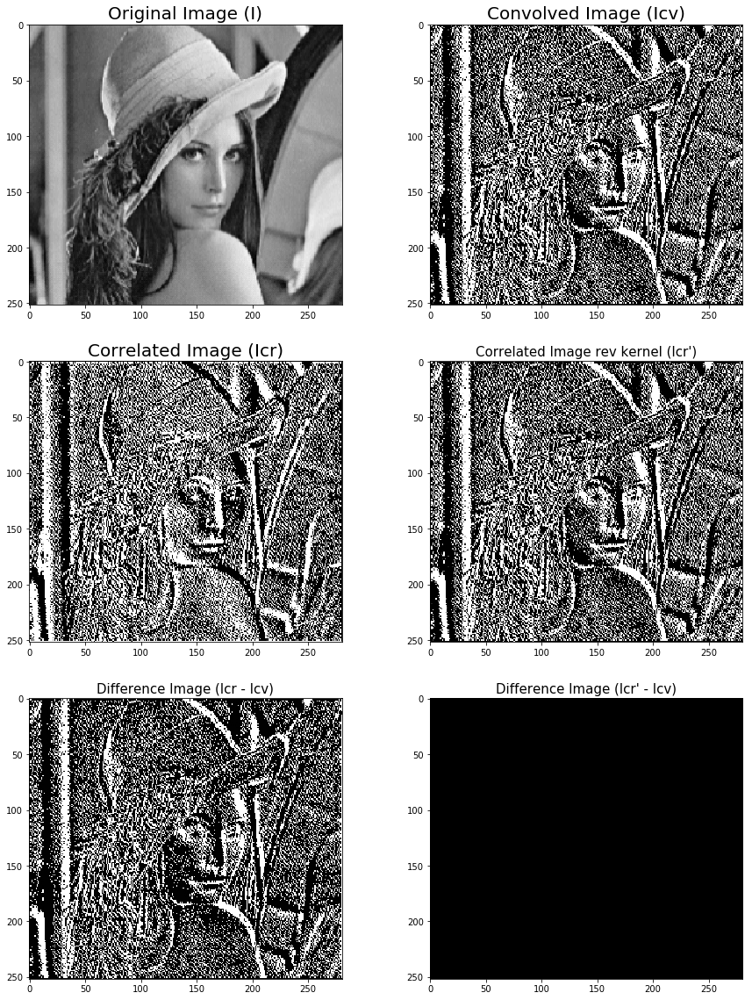

In [57]:
from scipy import misc, signal

im = np.mean(misc.imread('../images/lena_g.png'), axis=2).astype(np.uint8) # scale pixel values in [0,1] for each channel
print(np.max(im))
print(im.shape)

kernel = np.array([[0, -1, np.sqrt(2)], [1, 0, -1], [-np.sqrt(2), 1, 0]]) / np.sqrt(8) #array([[0, 0, 0], [-1, 1, 1], [1, -1, -1]]) 

im_convolved = np.clip(signal.convolve2d(im, kernel, mode='same'),0,1)
im_correlated = np.clip(signal.correlate2d(im, kernel, mode='same'),0,1)
im_correlated_rev = np.clip(signal.correlate2d(im, kernel[::-1,::-1], mode='same'),0,1)

plt.gray()
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(15, 20))

ax[0,0].imshow(im)
ax[0,0].set_title('Original Image (I)', size=20)

ax[0,1].imshow(im_convolved)
ax[0,1].set_title('Convolved Image (Icv)', size=20)

ax[1,0].imshow(im_correlated)
ax[1,0].set_title('Correlated Image (Icr)', size=20)

ax[1,1].imshow(im_correlated_rev)
ax[1,1].set_title('Correlated Image rev kernel (Icr\')', size=15)

ax[2,0].imshow((im_correlated - im_convolved).astype(np.uint8))
ax[2,0].set_title('Difference Image (Icr - Icv)', size=15)

ax[2,1].imshow((im_correlated_rev - im_convolved).astype(np.uint8))
ax[2,1].set_title('Difference Image (Icr\' - Icv)', size=15)

plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\matplotlib\figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


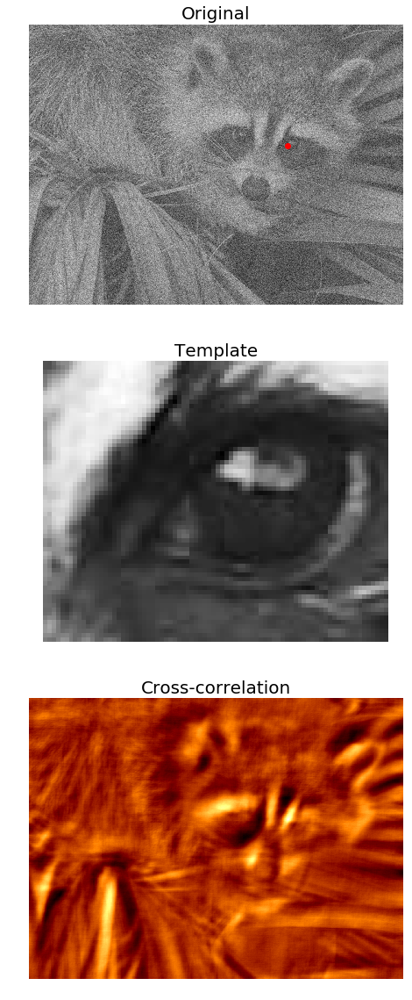

In [16]:
from scipy import signal
from scipy import misc
face = misc.face(gray=True) - misc.face(gray=True).mean()
template = np.copy(face[300:365, 670:750])  # right eye
template -= template.mean()
face = face + np.random.randn(*face.shape) * 50  # add noise
corr = signal.correlate2d(face, template, boundary='symm', mode='same')
y, x = np.unravel_index(np.argmax(corr), corr.shape)  # find the match

sharpen_kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
corr = signal.convolve2d(corr, sharpen_kernel, mode='same', boundary="symm")

import matplotlib.pyplot as plt
fig, (ax_orig, ax_template, ax_corr) = plt.subplots(3, 1,
                                                    figsize=(10, 20))
ax_orig.imshow(face, cmap='gray')
ax_orig.set_title('Original', size=20)
ax_orig.set_axis_off()
ax_template.imshow(template, cmap='gray')
ax_template.set_title('Template', size=20)
ax_template.set_axis_off()
ax_corr.imshow(corr, cmap='afmhot')
ax_corr.set_title('Cross-correlation', size=20)
ax_corr.set_axis_off()
ax_orig.plot(x, y, 'ro')
fig.show()

In [26]:
kernel = np.array([[-1, -1, -1], [1, 1, 1], [0, 0, 0]]) 
mat = np.reshape(np.arange(36), (6,6))
print(signal.convolve2d(mat, kernel))
print(signal.correlate2d(mat, kernel[::-1,::-1]))

[[  0  -1  -3  -6  -9 -12  -9  -5]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ 30  61  93  96  99 102  69  35]
 [  0   0   0   0   0   0   0   0]]
[[  0  -1  -3  -6  -9 -12  -9  -5]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ -6 -12 -18 -18 -18 -18 -12  -6]
 [ 30  61  93  96  99 102  69  35]
 [  0   0   0   0   0   0   0   0]]


1.0
(225, 225)


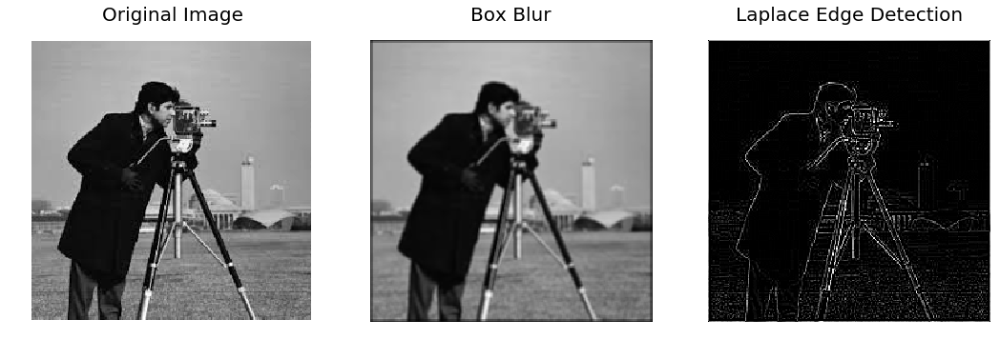

In [69]:
from scipy.misc import imread
from skimage.color import rgb2gray
from scipy import signal
im = rgb2gray(misc.imread('../images/cameraman.jpg')).astype(float)
print(np.max(im))
# 1.0
print(im.shape)
# (225, 225)
blur_box_kernel = np.ones((3,3)) / 9
edge_laplace_kernel = np.array([[0,1,0],[1,-4,1],[0,1,0]])
im_blurred = signal.convolve2d(im, blur_box_kernel)
im_edges = np.clip(signal.convolve2d(im, edge_laplace_kernel), 0, 1)
#im_edges[im_edges<0]=0
fig, ax = plt.subplots(ncols=3, sharex=True, sharey=True, figsize=(18, 6))
ax[0].imshow(im, cmap=plt.cm.gray)
ax[0].set_title('Original Image', size=20)
ax[1].imshow(im_blurred, cmap=plt.cm.gray)
ax[1].set_title('Box Blur', size=20)
ax[2].imshow(im_edges, cmap=plt.cm.gray)
ax[2].set_title('Laplace Edge Detection', size=20)
for a in ax:
 a.axis('off')
plt.show()

0.951033332408


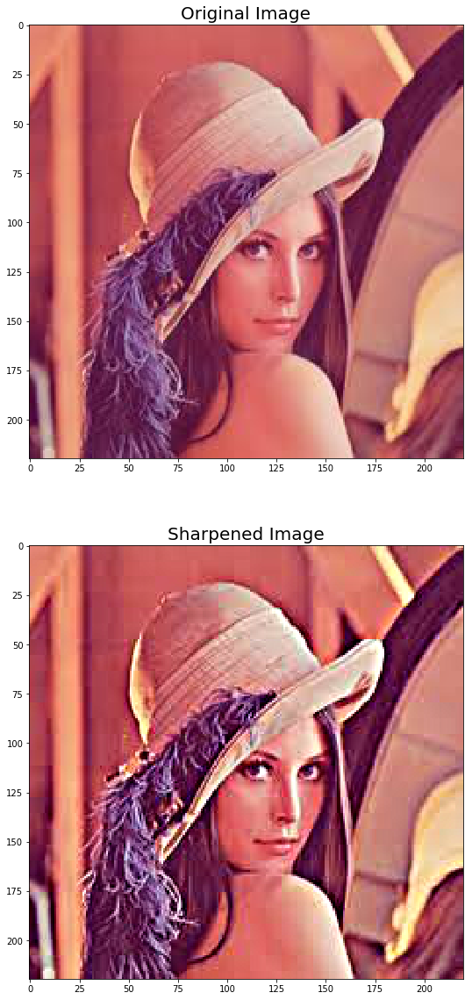

In [111]:
from scipy import misc, signal, ndimage

im = misc.imread('../images/lena.jpg') / 255 # scale pixel values in [0,1] for each channel

#blur_box_kernel = np.reshape(np.ones((11,11)) / 121, (11,11,1))

# First a 1-D  Gaussian
t = np.linspace(-10, 10, 30)
bump = np.exp(-0.1*t**2)
bump /= np.trapz(bump) # normalize the integral to 1

# make a 2-D kernel out of it
kernel = bump[:, np.newaxis] * bump[np.newaxis, :]

im_blur = ndimage.convolve(im, kernel.reshape(30,30,1)) #.astype(np.uint8)

#im_blur = gaussian_filter(im, sigma=(0.5,0.5,0))
#print(np.max(im_blur))

im_sharp = np.clip(2*im - im_blur, 0, 1)

fig, ax = plt.subplots(nrows=2, figsize=(10, 20))

ax[0].imshow(im)
ax[0].set_title('Original Image', size=20)

ax[1].imshow(im_sharp)
ax[1].set_title('Sharpened Image', size=20)

plt.show()

1.0
1.05942226754


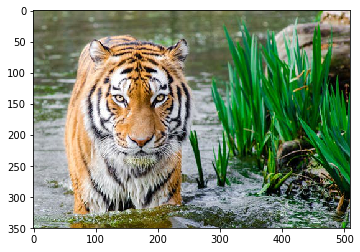

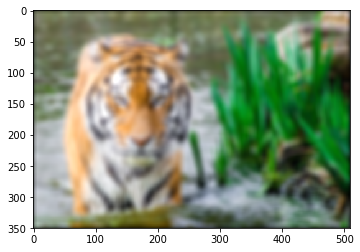

In [61]:
from scipy import signal

im = plt.imread('../new images/tiger.jpeg') / 255
plt.figure()
plt.imshow(im)
print(np.max(im))
# First a 1-D  Gaussian
t = np.linspace(-10, 10, 15)
bump = np.exp(-0.01*t**2)
bump /= np.trapz(bump) # normalize the integral to 1
# make a 2-D kernel out of it
kernel = bump[:, np.newaxis] * bump[np.newaxis, :]

# mode='same' is there to enforce the same output shape as input arrays
# (ie avoid border effects)
im = signal.fftconvolve(im, kernel[:, :, np.newaxis], mode='same')
plt.figure()
plt.imshow(np.clip(im, 0, 1))
print(np.max(im))


(640, 360) 0.99858627451
(640, 360) (6.28318523994+0j)
0.99858627451 0.55655547108 255.0 147.40688989


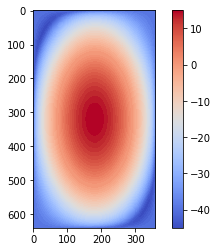

In [67]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from skimage.color import rgb2gray
from skimage.io import imread
import scipy.fftpack as fp

im = rgb2gray(imread('../my images/me.jpg')) 
print(im.shape, np.max(im))
#kernel1 = np.outer(signal.gaussian(im.shape[0], 0.1), signal.gaussian(im.shape[1], 0.1))
#kernel2 = np.outer(signal.gaussian(im.shape[0], 1), signal.gaussian(im.shape[1], 1))
#kernel = kernel2 - kernel1 # DOGkernel 
kernel = np.outer(signal.gaussian(im.shape[0], 1), signal.gaussian(im.shape[1], 1))
freq = fp.fft2(im)
assert(freq.shape == kernel.shape)
freq_kernel = fp.fft2(fp.ifftshift(kernel))
print(freq_kernel.shape, np.max(freq_kernel))
convolved = freq*freq_kernel
im_blur = fp.ifft2(convolved).real
im_blur = 255 * im_blur / np.max(im_blur)
print(np.max(im), np.mean(im), np.max(im_blur), np.mean(im_blur))

plt.imshow( (20*np.log10( 0.01 + fp.fftshift(freq_kernel))).real.astype(int), cmap='coolwarm')
plt.colorbar()
plt.show()

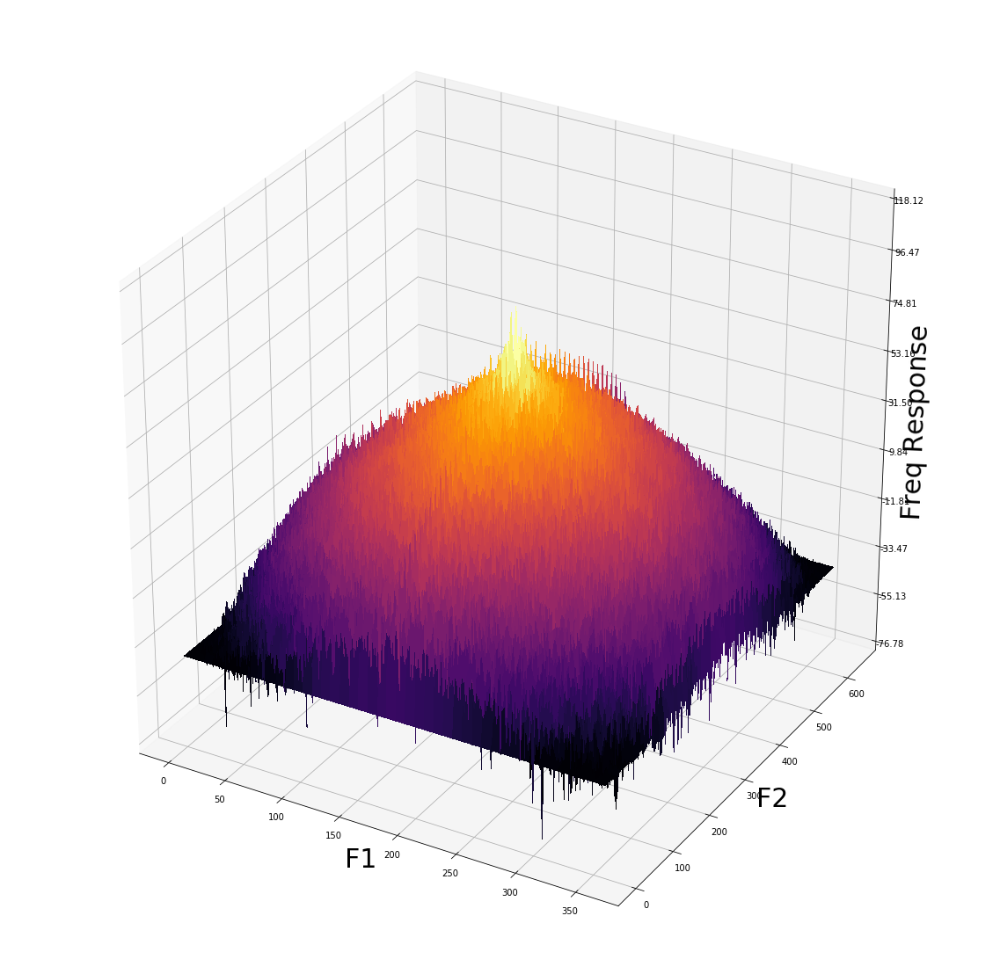

In [70]:
% matplotlib inline
fig = plt.figure(figsize=(20,20))
ax = fig.gca(projection='3d')
Y = np.arange(freq.shape[0]) #-freq.shape[0]//2,freq.shape[0]-freq.shape[0]//2)
X = np.arange(freq.shape[1]) #-freq.shape[1]//2,freq.shape[1]-freq.shape[1]//2)
X, Y = np.meshgrid(X, Y)
#Z = (20*np.log10( 0.01 + fp.fftshift(freq_kernel))).real
#Z = np.absolute(fp.fftshift(freq_kernel))#.real
#Z = (20*np.log10( 0.01 + fp.fftshift(freq))).real
#print(X.shape, Y.shape, Z.shape)
Z = (20*np.log10( 0.01 + fp.fftshift(convolved))).real

# Plot the surface.
surf = ax.plot_surface(X, Y, Z, cmap=cm.inferno, linewidth=0, antialiased=False)
#ax.set_zscale("log", nonposx='clip')
#ax.set_xlim((1000,3000))
#ax.set_ylim((1000,3000))
#ax.zaxis.set_scale('log')
ax.zaxis.set_major_locator(LinearLocator(10))
ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))
ax.set_xlabel('F1', size=30)
ax.set_ylabel('F2', size=30)
ax.set_zlabel('Freq Response', size=30)
# Add a color bar which maps values to colors.
#fig.colorbar(surf, ax, shrink=0.5, aspect=5)
#plt.title('Frequency Response of the Gaussian Kernel')
plt.show()

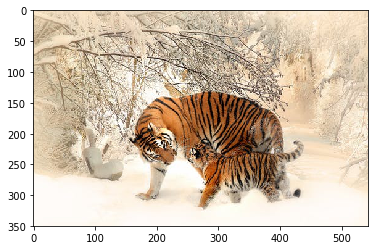

1.0
0.786219236355


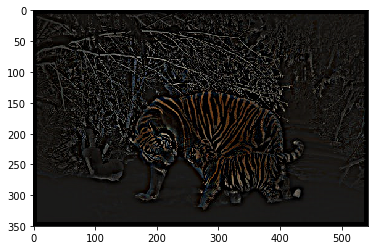

In [12]:
from scipy import signal
import matplotlib.pylab as plt
import numpy as np

im = plt.imread('../new images/tigers.jpeg') / 255
plt.figure()
plt.imshow(im)
plt.show()
print(np.max(im))
# First a 1-D  Gaussian
t = np.linspace(-10, 10, 15)
bump = np.exp(-0.005*t**2)
bump /= np.trapz(bump) # normalize the integral to 1
# make a 2-D kernel out of it
kernel = bump[:, np.newaxis] * bump[np.newaxis, :]

bump = np.exp(-5*t**2)
bump /= np.trapz(bump) # normalize the integral to 1
# make a 2-D kernel out of it
kernel2 = bump[:, np.newaxis] * bump[np.newaxis, :]

DoGKernel = kernel[:, :, np.newaxis] - kernel2[:, :, np.newaxis]

# mode='same' is there to enforce the same output shape as input arrays
# (ie avoid border effects)
im = signal.fftconvolve(im, DoGKernel, mode='same')
plt.figure()
plt.imshow(np.clip(im, 0, 1))
print(np.max(im))
plt.show()

In [9]:
from scipy import signal
import numpy.fft as fp
import matplotlib.pyplot as plt

im = np.mean(imread('../images/lena.jpg'), axis=2)
im1 = np.zeros((2*im.shape[0], 2*im.shape[1]))
print(im.shape, im1.shape)
for i in range(im.shape[0]):
    for j in range(im.shape[1]):
        im1[2*i,2*j] = im[i,j]

(220, 220) (440, 440)


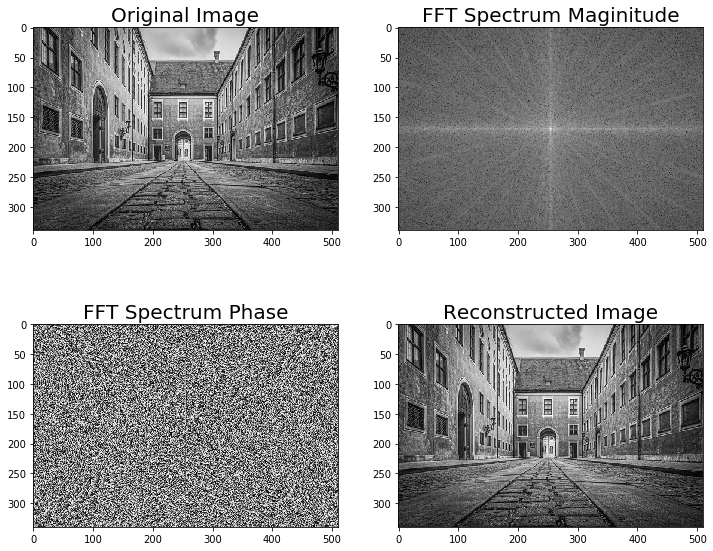

In [142]:
import numpy.fft as fp
% matplotlib inline
im1 = rgb2gray(imread('../new images/house1.jpg'))
plt.figure(figsize=(12,10))
freq1 = fp.fft2(im1)
im1_ = fp.ifft2(freq1).real
plt.subplot(2,2,1)
plt.imshow(im1, cmap='gray')
plt.title('Original Image', size=20)
plt.subplot(2,2,2)
plt.imshow(20*np.log10( 0.01 + np.abs(fp.fftshift(freq1))), cmap='gray')
plt.title('FFT Spectrum Maginitude', size=20)
plt.subplot(2,2,3)
plt.imshow(np.angle(fp.fftshift(freq1)), cmap='gray')
plt.title('FFT Spectrum Phase', size=20)
plt.subplot(2,2,4)
plt.imshow(np.clip(im1_,0,255), cmap='gray')
plt.title('Reconstructed Image', size=20)
plt.show()

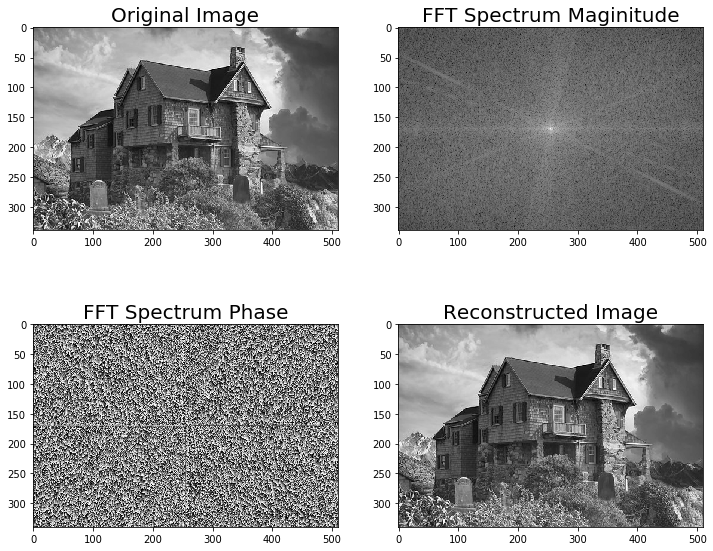

In [143]:
% matplotlib inline
im2 = rgb2gray(imread('../new images/house2.jpg'))
plt.figure(figsize=(12,10))
freq2 = fp.fft2(im2)
im2_ = fp.ifft2(freq2).real
plt.subplot(2,2,1)
plt.imshow(im2, cmap='gray')
plt.title('Original Image', size=20)
plt.subplot(2,2,2)
plt.imshow(20*np.log10( 0.01 + np.abs(fp.fftshift(freq2))), cmap='gray')
plt.title('FFT Spectrum Maginitude', size=20)
plt.subplot(2,2,3)
plt.imshow(np.angle(fp.fftshift(freq2)), cmap='gray')
plt.title('FFT Spectrum Phase', size=20)
plt.subplot(2,2,4)
plt.imshow(np.clip(im2_,0,255), cmap='gray')
plt.title('Reconstructed Image', size=20)
plt.show()

In [152]:
type(freq1)
freq1.shape
type(freq1.real)

numpy.ndarray

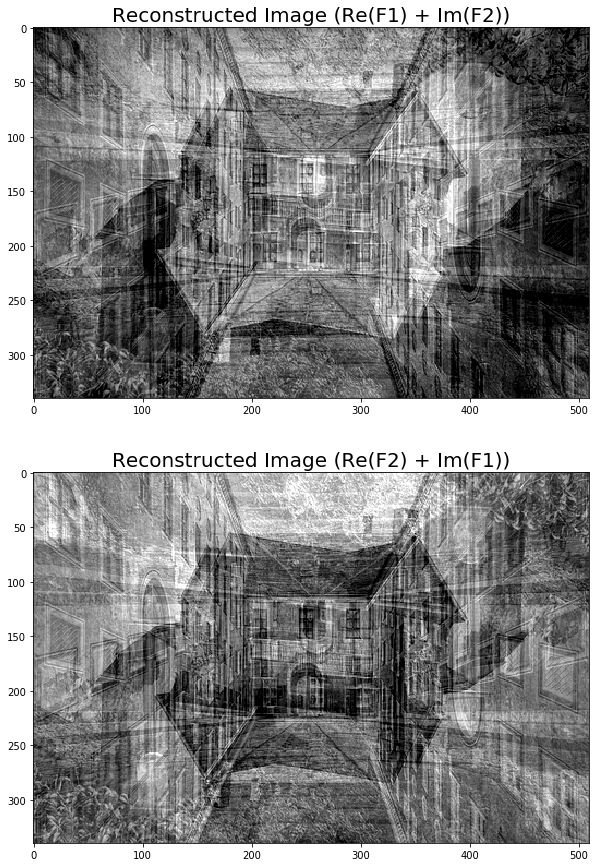

In [155]:
plt.figure(figsize=(20,15))
im1 = fp.ifft2(np.vectorize(complex)(freq1.real, freq2.imag)).real
im2 = fp.ifft2(np.vectorize(complex)(freq2.real, freq1.imag)).real
plt.subplot(211)
plt.imshow(np.clip(im1,0,255).astype(np.uint8), cmap='gray')
plt.title('Reconstructed Image (Re(F1) + Im(F2))', size=20)
plt.subplot(212)
plt.imshow(np.clip(im2,0,255).astype(np.uint8), cmap='gray')
plt.title('Reconstructed Image (Re(F2) + Im(F1))', size=20)
plt.show()

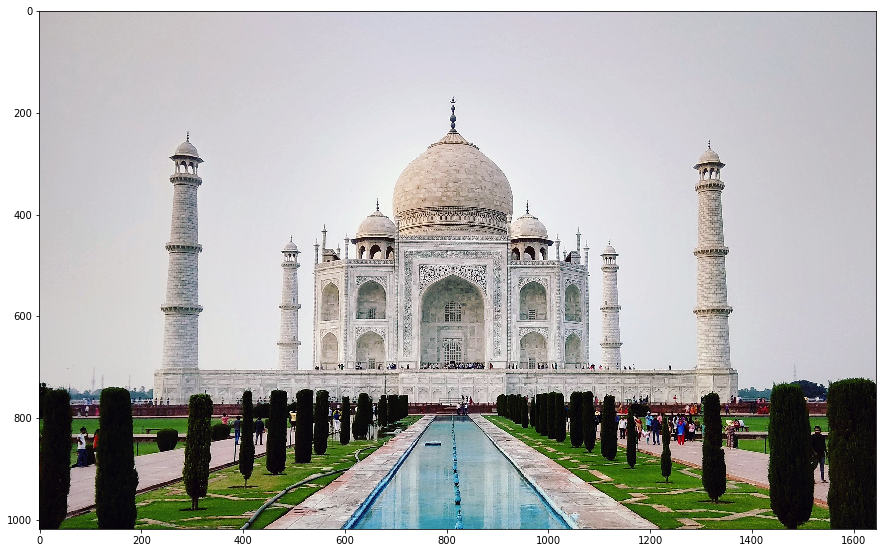

In [104]:
im = Image.open("../new images/tajmahal.jpg")
plt.figure(figsize=(15,10))
plt.imshow(im)
#im.show()

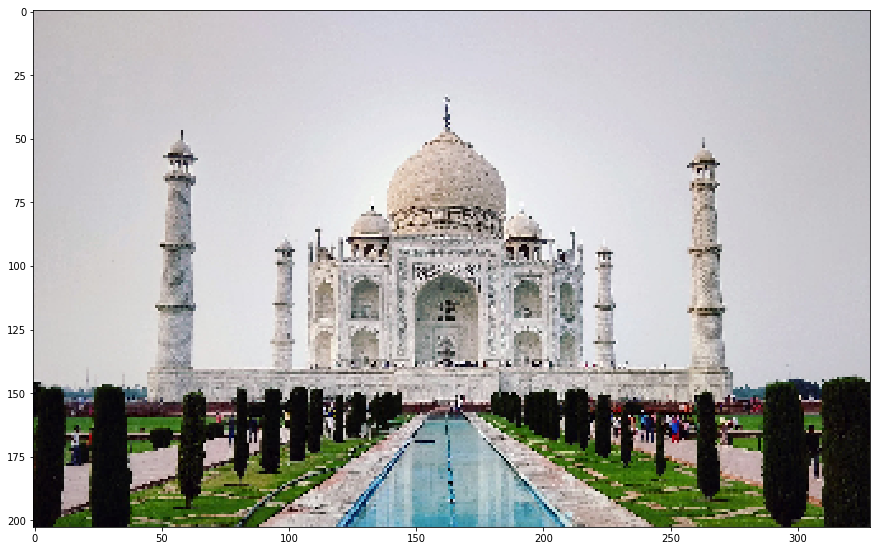

In [101]:
im = im.resize((im.width//5, im.height//5))
im.save("../new images/tajmahal_small.jpg")
plt.figure(figsize=(15,10))
plt.imshow(im)

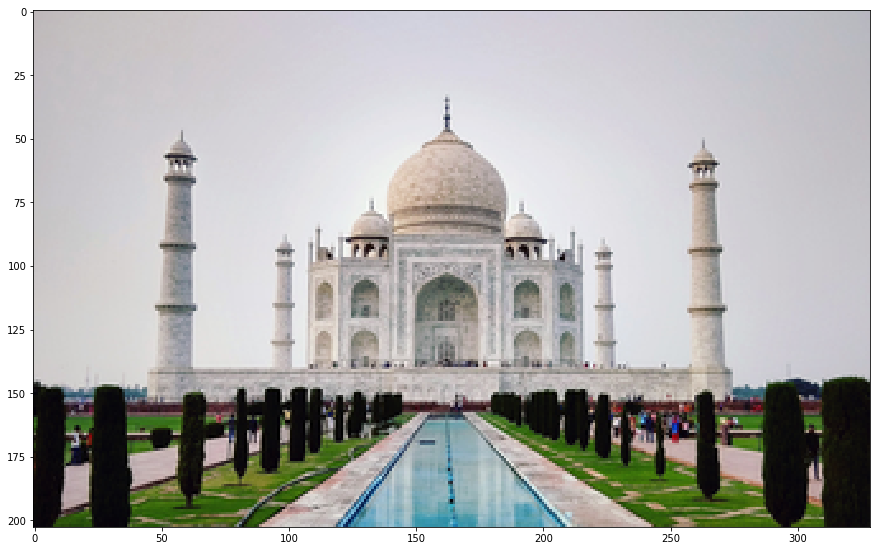

In [103]:
im = im.resize((im.width//5, im.height//5), Image.ANTIALIAS)
im.save("../new images/tajmahal_small.jpg")
plt.figure(figsize=(15,10))
plt.imshow(im)

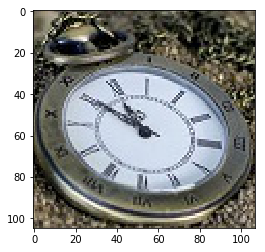

In [111]:
im = Image.open("../new images/clock.jpg") # the original image
plt.imshow(im)
plt.show()

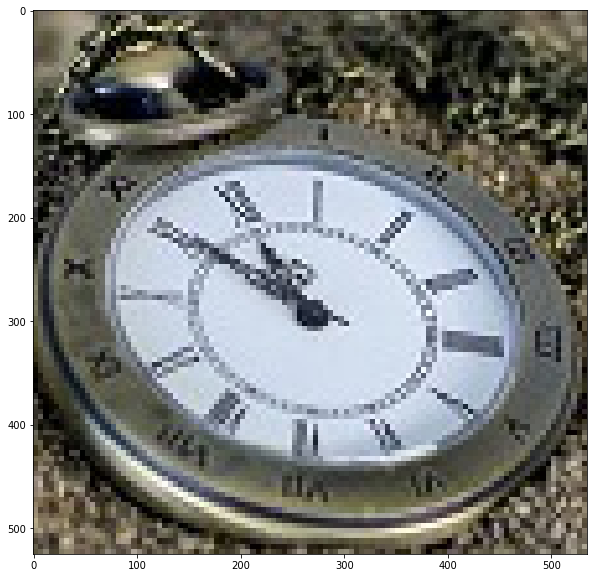

In [118]:
im1 = im.resize((im.width*5, im.height*5), Image.NEAREST)  # nearest neighbor interpolation
plt.figure(figsize=(10,10))
plt.imshow(im1)
plt.show()

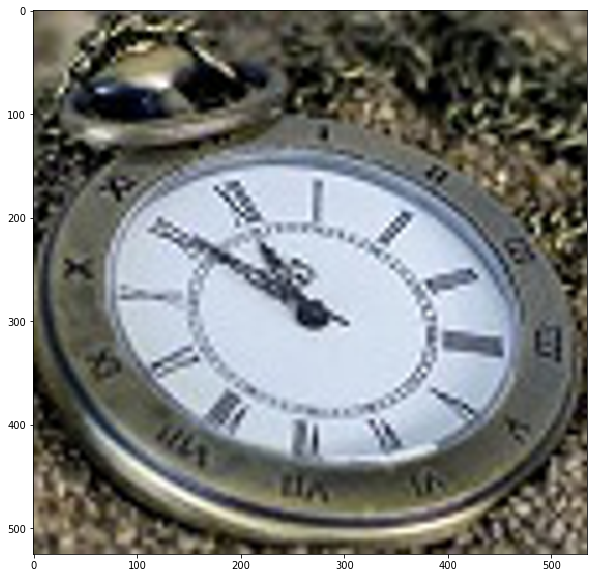

In [119]:
im1 = im.resize((im.width*5, im.height*5), Image.BICUBIC)  # nearest neighbor interpolation
plt.figure(figsize=(10,10))
plt.imshow(im1)
plt.show()

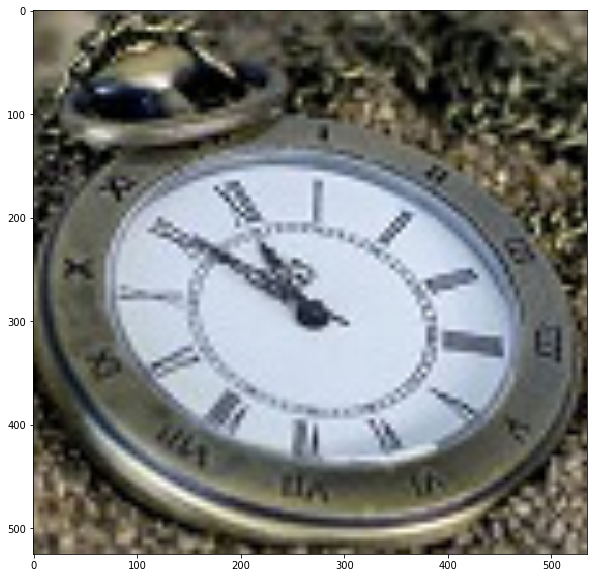

In [120]:
im1 = im.resize((im.width*5, im.height*5), Image.BILINEAR)  # nearest neighbor interpolation
plt.figure(figsize=(10,10))
plt.imshow(im1)
plt.show()